## GRB230307A CARMA Model using EzTAO and Dynesty

I'm going to do simulated data from scratch, and then see if I can sample that model using NUTS or Nested SAmpling in Numpyro:

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")

import pickle
import numpy as np
import scipy.io

# Need both Jax and Tensorflow Probability 
import jax
# Important to enable 64-bit precision
jax.config.update("jax_enable_x64", True)
import jax.numpy as jnp
from jax import random
import tensorflow_probability.substrates.jax as tfp

# TinyGP for Gaussian Processes, JaxNS for sampling
from tinygp import GaussianProcess, kernels
from tinygp.kernels.quasisep import CARMA

from jaxns.utils import resample

#stingray imports
import stingray
from stingray import Lightcurve, Powerspectrum
from stingray.modeling.gpmodeling import get_kernel, get_mean
from stingray.modeling.gpmodeling import get_prior, get_log_likelihood, get_gp_params
from stingray.modeling.gpmodeling import _skew_gaussian

# suppress warnings
import warnings
warnings.filterwarnings("ignore")

# abbreviations for tensorflow distributions + bijectors
tfpd = tfp.distributions
tfpb = tfp.bijectors

import numpyro
import numpyro.distributions as dist
from numpyro.infer import MCMC, NUTS
from numpyro.contrib.nested_sampling import NestedSampler

import arviz as az

INFO[2023-10-20 14:31:55,553]: Unable to initialize backend 'cuda': module 'jaxlib.xla_extension' has no attribute 'GpuAllocatorConfig'
I0000 00:00:1697805115.553061       1 tfrt_cpu_pjrt_client.cc:349] TfrtCpuClient created.
INFO[2023-10-20 14:31:55,555]: Unable to initialize backend 'rocm': module 'jaxlib.xla_extension' has no attribute 'GpuAllocatorConfig'
INFO[2023-10-20 14:31:55,565]: Unable to initialize backend 'tpu': INTERNAL: Failed to open libtpu.so: dlopen(libtpu.so, 0x0001): tried: 'libtpu.so' (no such file), '/System/Volumes/Preboot/Cryptexes/OSlibtpu.so' (no such file), '/opt/miniconda3/envs/grbsearch/bin/../lib/libtpu.so' (no such file), '/usr/lib/libtpu.so' (no such file, not in dyld cache), 'libtpu.so' (no such file), '/usr/local/lib/libtpu.so' (no such file), '/usr/lib/libtpu.so' (no such file, not in dyld cache)
/Users/daniela/work/repositories/stingraysoftware/stingray/stingray/utils.py:35: UserWarning: pyfftw not installed. Using standard scipy fft
  warnings.warn(

In [2]:
import eztao
from eztao.carma import CARMA_term
from eztao.ts import gpSimRand
from eztao.ts import mcmc
import emcee
import corner


## Test 1: A CARMA light curve without mean function

Let's first simulate a CARMA light curve without mean function:

In [3]:
import celerite
from celerite import terms


INFO[2023-10-20 14:32:18,898]: Checking if light curve is well behaved. This can take time, so if you are sure it is already sorted, specify skip_checks=True at light curve creation.
INFO[2023-10-20 14:32:18,962]: Checking if light curve is sorted.
INFO[2023-10-20 14:32:19,044]: Computing the bin time ``dt``. This can take time. If you know the bin time, please specify it at light curve creation


[-0.12010985 -0.13898478 -0.15817653 ...  0.23710501  0.20218336
  0.19925159]
1.1226230684520564


<IPython.core.display.Javascript object>


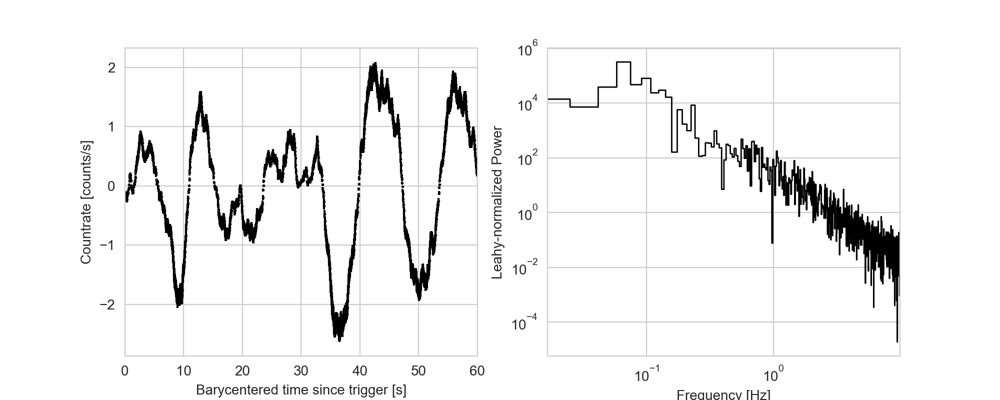

Text(0, 0.5, 'Leahy-normalized Power')

In [4]:
dt = 0.05
tseg = 60.0

time = np.linspace(0, 60, int(60/0.05))

alpha = [10.5, 1.5, 2.0]
beta = [1, 4.0]
sigma = 4.0

mean_val = 100.0

#kernel_params_true = {"alpha": alpha,
#                      "beta": beta,
#                      "acarma": sigma}

kernel_params_true = np.hstack([alpha, beta])

carma30_kernel = CARMA_term(np.log(alpha), np.log(beta))
#gp = GaussianProcess(kernel, time, diag=0.01)
gp = celerite.GP(carma30_kernel)
gp.compute(time)

#key = random.PRNGKey(1200)
sample = gp.sample()# + mean_val
#sample = np.random.poisson(sample)
print(sample)
#gp.condition(sample)
#print(gp.log_probability(sample))
print(np.var(sample))
lcsample = Lightcurve(time, sample)
pssample = Powerspectrum(lcsample, norm="frac")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.errorbar(lcsample.time, lcsample.counts, yerr=np.sqrt(np.abs(lcsample.counts))/10, 
             fmt="o", markersize=1, color="black")
ax1.set_xlim(lcsample.time[0], lcsample.time[-1])
ax1.set_xlabel("Barycentered time since trigger [s]")
ax1.set_ylabel("Countrate [counts/s]")

ax2.loglog(pssample.freq, pssample.power, ds="steps-mid", lw=1, color="black")
ax2.set_xlim(pssample.freq[0], pssample.freq[-1])
ax2.set_xlabel("Frequency [Hz]")
ax2.set_ylabel("Leahy-normalized Power")


#def plot_kernel(kernel, **kwargs):
#    dx = np.linspace(0, 5, 100)
#    plt.figure()
#    plt.plot(dx, kernel(dx, dx[:1]), **kwargs)
#    plt.xlabel("dx")
#    plt.ylabel("k(dx)")


#plot_kernel(kernel)

### Basic Setup with MCMC using emcee

In [5]:
from eztao.ts import neg_param_ll, neg_fcoeff_ll

In [6]:
def param_ll(*args):
    return -neg_param_ll(*args)

def fcoeff_ll(*args):
    return -neg_fcoeff_ll(*args)

In [7]:
true_fcoeffs = CARMA_term.carma2fcoeffs_log(np.log(alpha), np.log(beta))

In [8]:
import emcee

In [166]:
ndim, nwalkers = len(true_fcoeffs), 32
sampler_cm30 = emcee.EnsembleSampler(nwalkers, ndim, fcoeff_ll, args=[sample, gp])

In [167]:
print("Running burn-in...")
p0 = true_fcoeffs + 1e-8 * np.random.randn(nwalkers, ndim)
p0, lp, _ = sampler_cm30.run_mcmc(p0, 2000)


Running burn-in...


In [168]:
print("Running production...")
sampler_cm30.reset()
sampler_cm30.run_mcmc(p0, 2000);


Running production...


<IPython.core.display.Javascript object>


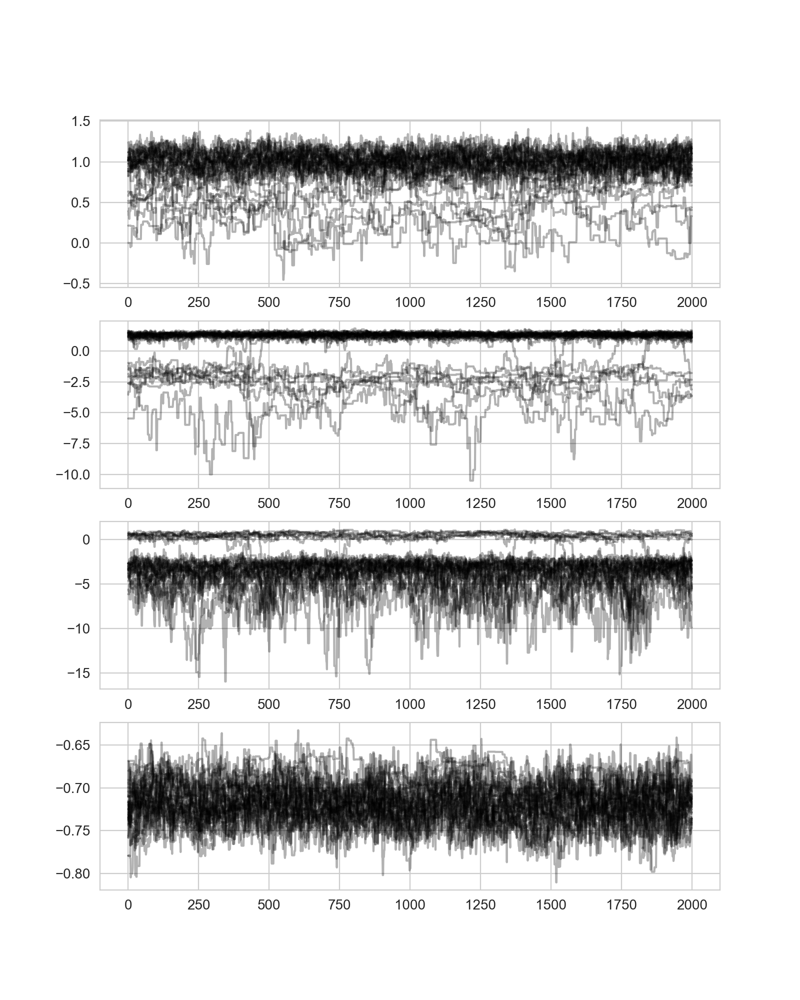

In [173]:
fig, axes = plt.subplots(4, 1, figsize=(8,10))

axes = np.hstack(axes)

for i in range(sampler_cm30.chain.shape[-1]):
    
    chain = sampler_cm30.chain[:,:,i]
    
    axes[i].plot(chain.T, color="black", alpha=0.3)

In [174]:
p = 3

<IPython.core.display.Javascript object>


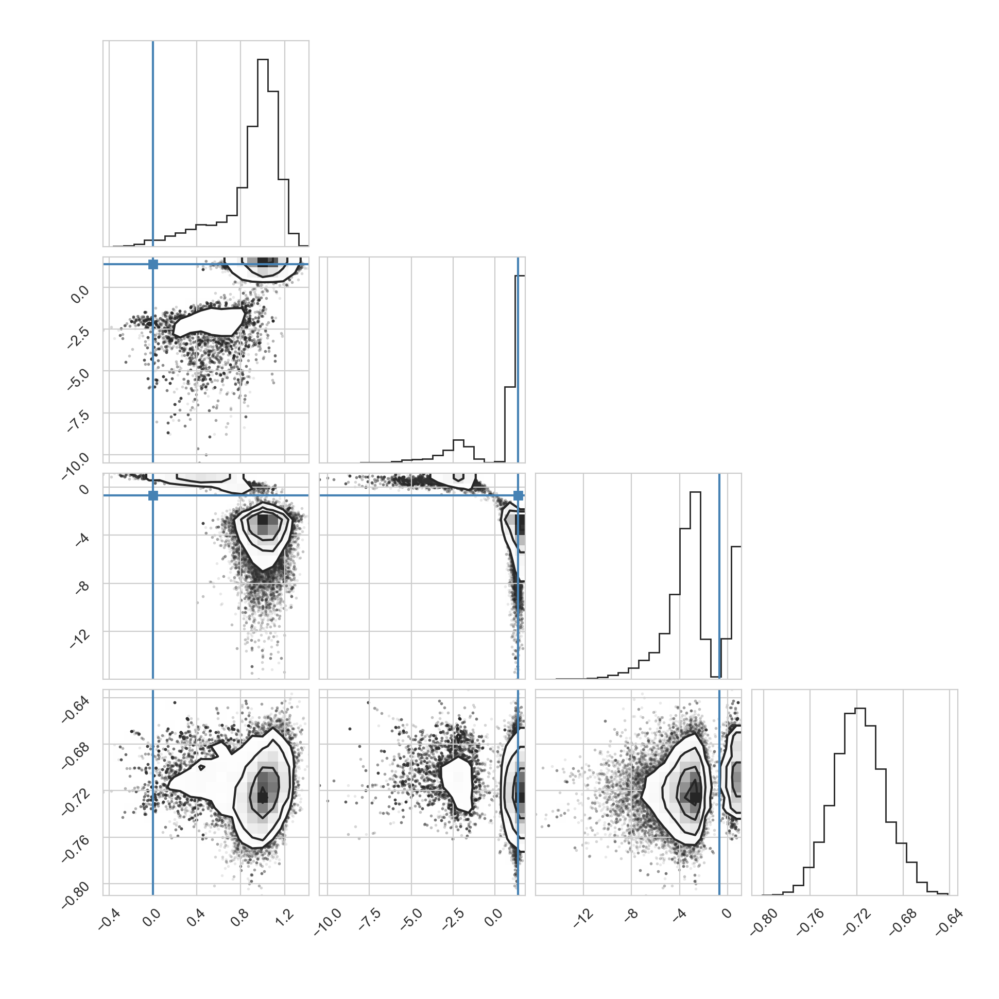

In [175]:
corner.corner(sampler_cm30.flatchain, truths=true_fcoeffs,
              title_kwargs={"fontsize": 12});


In [177]:
# from the polynomial space to CARMA space
vec_fcoeff2carma_log = np.vectorize(CARMA_term.fcoeffs2carma_log, excluded=[1,],
                                signature="(n)->(m),(k)")
logAR, logMA = vec_fcoeff2carma_log(sampler_cm30.flatchain, p)
cm30_flatchain = np.hstack((logAR, logMA))


<IPython.core.display.Javascript object>


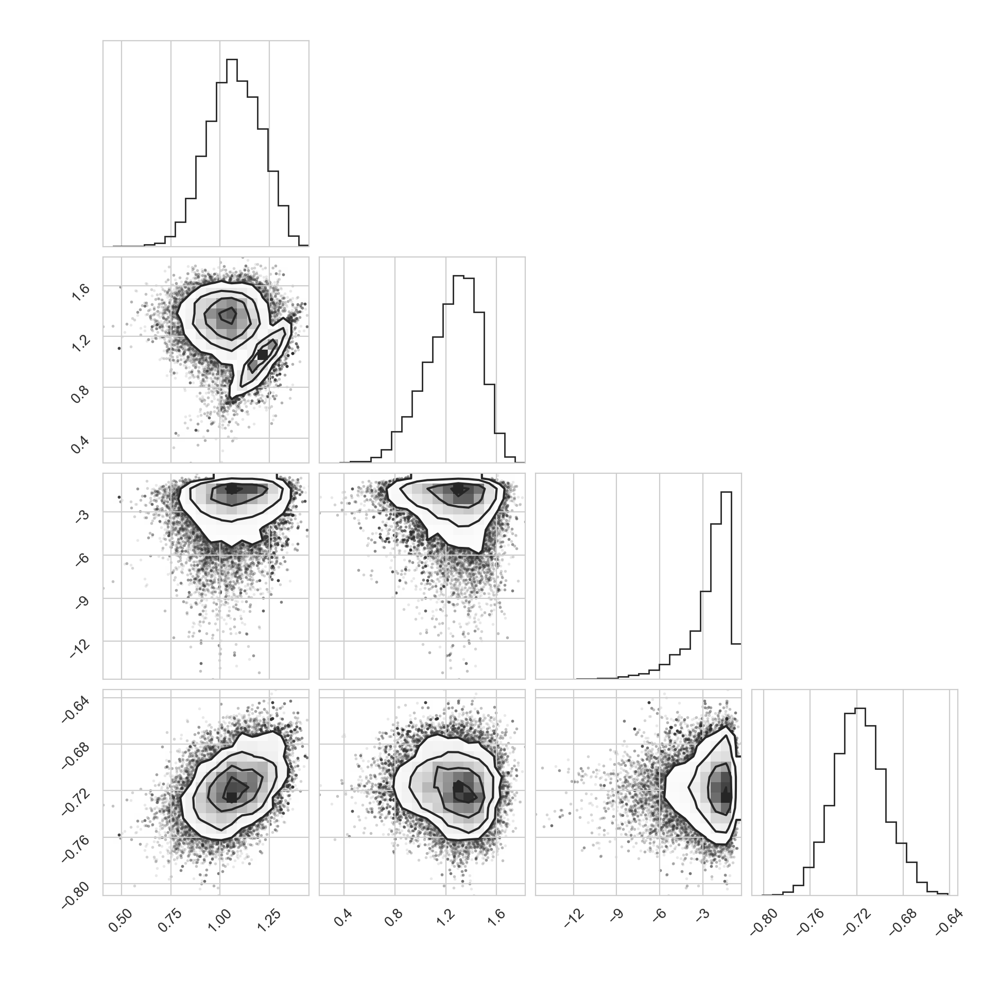

In [178]:
corner.corner(cm30_flatchain,
              title_kwargs={"fontsize": 12});


In [179]:
alpha

[1.5, 4.5, 2.0]

In [180]:
beta

[10.5]

In [72]:
cm30_flatchain

array([[ 1.02915017,  1.38321461, -1.75150727, -0.72905127],
       [ 1.07956717,  1.40463726, -3.09093668, -0.75232827],
       [ 1.16369051,  0.81060088, -2.07989962, -0.72982074],
       ...,
       [ 1.01259836,  1.42311133, -8.6484754 , -0.74859676],
       [ 0.90707629,  1.55162715, -2.49057337, -0.7305122 ],
       [ 0.88841918,  1.23191459, -3.5766001 , -0.71105774]])

<IPython.core.display.Javascript object>


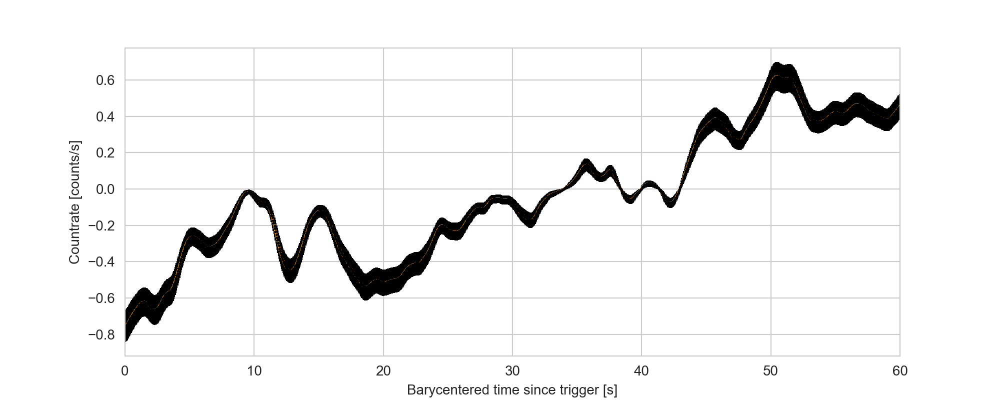

[ 1.03624338  1.32737315 -1.07700095 -0.72623076]
[ 1.00243538  1.26085746 -1.99768479 -0.70121756]
[ 1.26668186  1.11826213 -2.65689928 -0.66997906]
[ 0.8330535   1.44573288 -8.87556975 -0.73524987]
[ 0.97583783  1.22872279 -1.53294996 -0.77950741]
[ 0.81331059  1.10373738 -2.50604144 -0.74678053]
[ 0.88187715  1.50118504 -5.59916517 -0.76277471]
[ 0.83474613  1.16488534 -2.43349155 -0.77301093]
[ 1.14558398  1.39147456 -1.3975774  -0.74694235]
[ 1.0280638   1.35283479 -3.01408529 -0.7569907 ]
[ 0.87539579  1.27250562 -0.71851908 -0.75932429]
[ 1.02515355  1.46622226 -4.1559696  -0.7453332 ]
[ 1.31212134  1.22753738 -1.51783353 -0.70836898]
[ 1.02409799  1.12327472 -7.39432711 -0.71349883]
[ 0.69755875  1.37001768 -6.93667424 -0.80827156]
[ 1.14969028  0.91368988 -6.02529015 -0.72523654]
[ 1.10144664  0.78843149 -2.55720751 -0.74855145]
[ 1.09624512  1.37044701 -6.54154969 -0.76063635]
[ 1.315157    1.12630264 -8.36027747 -0.71652333]
[ 0.89942957  1.1602837  -0.88655379 -0.75285325]


In [79]:

fig, ax1 = plt.subplots(1, 1, figsize=(10,4))

ax1.errorbar(lcsample.time, lcsample.counts, yerr=np.sqrt(np.abs(lcsample.counts))/10, 
             fmt="o", markersize=1, color="black")
ax1.set_xlim(lcsample.time[0], lcsample.time[-1])
ax1.set_xlabel("Barycentered time since trigger [s]")
ax1.set_ylabel("Countrate [counts/s]")

t_pred = np.linspace(lcsample.time[0], lcsample.time[-1], 2500)

idx_all = np.random.choice(np.arange(0, cm30_flatchain.shape[0], 1, dtype=int), size=25, replace=False)

for idx in idx_all:
    params = cm30_flatchain[idx,:]
    print(params)

    # get ar, ma
    ar = params[:p]
    ma = params[p:]

    # init kernel, gp and compute matrix
    kernel = CARMA_term(ar, ma)
    gp = celerite.GP(kernel, mean=0)
    gp.compute(lcsample.time)

    mu, var = gp.predict(lcsample.counts, t_pred, return_var=False)
    ax1.plot(t_pred, mu, color="orange")

Okay, that basic version seems to be working. 

### Nested Sampling with Dynesty

Let's try this with Dynesty, too.

In [9]:
import dynesty

In [10]:
def prior_transform(u):
    """Transforms the uniform random variable `u ~ Unif[0., 1.)`
    to the parameter of interest `x ~ Unif[-10., 10.)`."""
    
    log_alpha1 = u[0]
    log_alpha2 = u[1]
    log_alpha3 = u[2]
    log_beta = u[3]
        
    x1 = 2. * log_alpha1 - 1.  # scale and shift to [-1., 1.)
    x1 *= 10.  # scale to [-10., 10.)

    x2 = 2. * log_alpha2 - 1.  # scale and shift to [-1., 1.)
    x2 *= 10.  # scale to [-10., 10.)

    x3 = 2. * log_alpha3 - 1.  # scale and shift to [-1., 1.)
    x3 *= 10.  # scale to [-10., 10.)

    x4 = 2. * log_beta - 1.  # scale and shift to [-1., 1.)
    x4 *= 10.  # scale to [-10., 10.)

    x = np.array([x1, x2, x3, x4])
    return x


In [11]:
from dynesty import NestedSampler

In [16]:
sampler = NestedSampler(fcoeff_ll, prior_transform, ndim, logl_args=(sample, gp))

NameError: name 'ndim' is not defined

In [84]:
sampler.run_nested()

8348it [00:51, 162.61it/s, +500 | bound: 76 | nc: 1 | ncall: 75049 | eff(%): 11.869 | loglstar:   -inf < 8729.946 <    inf | logz: 8713.962 +/-    nan | dlogz:  0.001 >  0.509]


In [45]:
res1 = sampler.results

In [46]:
res1.summary()

Summary
nlive: 500
niter: 8370
ncall: 90714
eff(%):  9.778
logz: 8713.906 +/-  0.304


In [12]:
from dynesty import plotting as dyplot

<IPython.core.display.Javascript object>


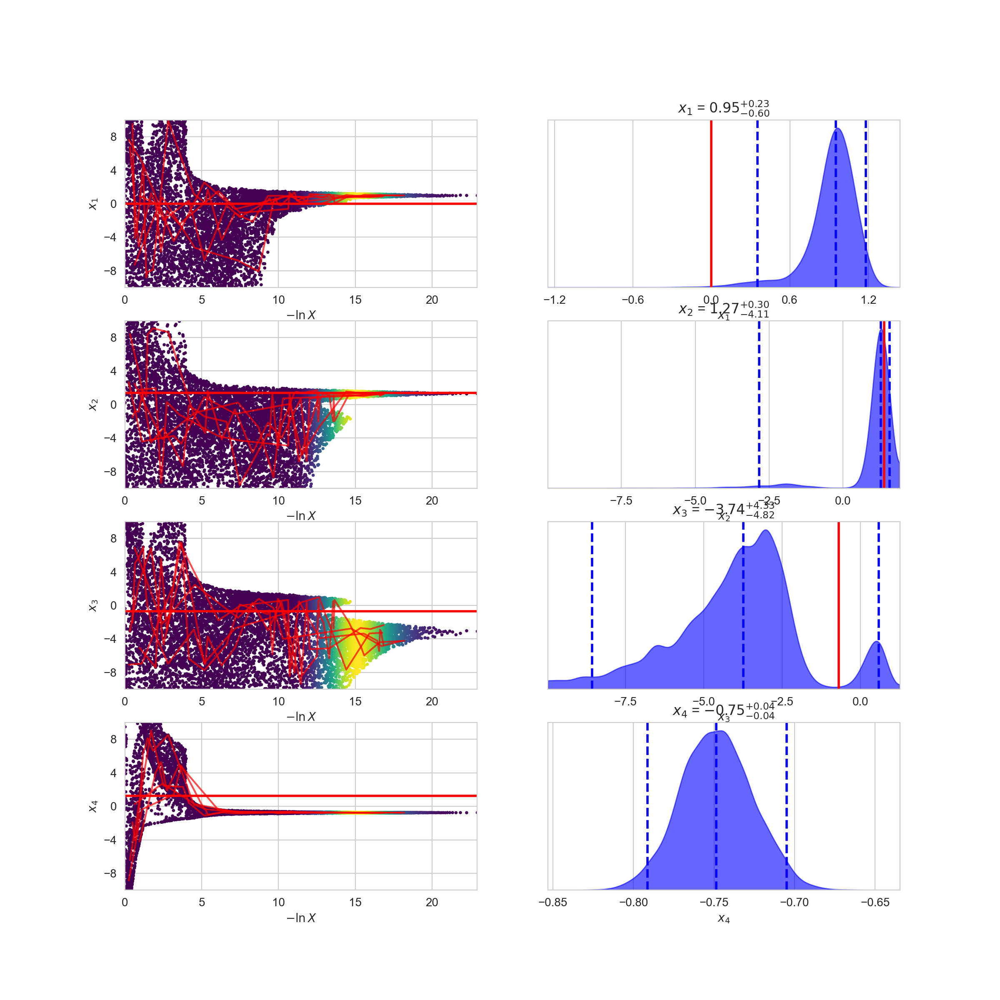

In [51]:
fig, axes = dyplot.traceplot(res1,show_titles=True, truths=true_fcoeffs,
                             trace_cmap='viridis', connect=True,
                             connect_highlight=range(5))


<IPython.core.display.Javascript object>


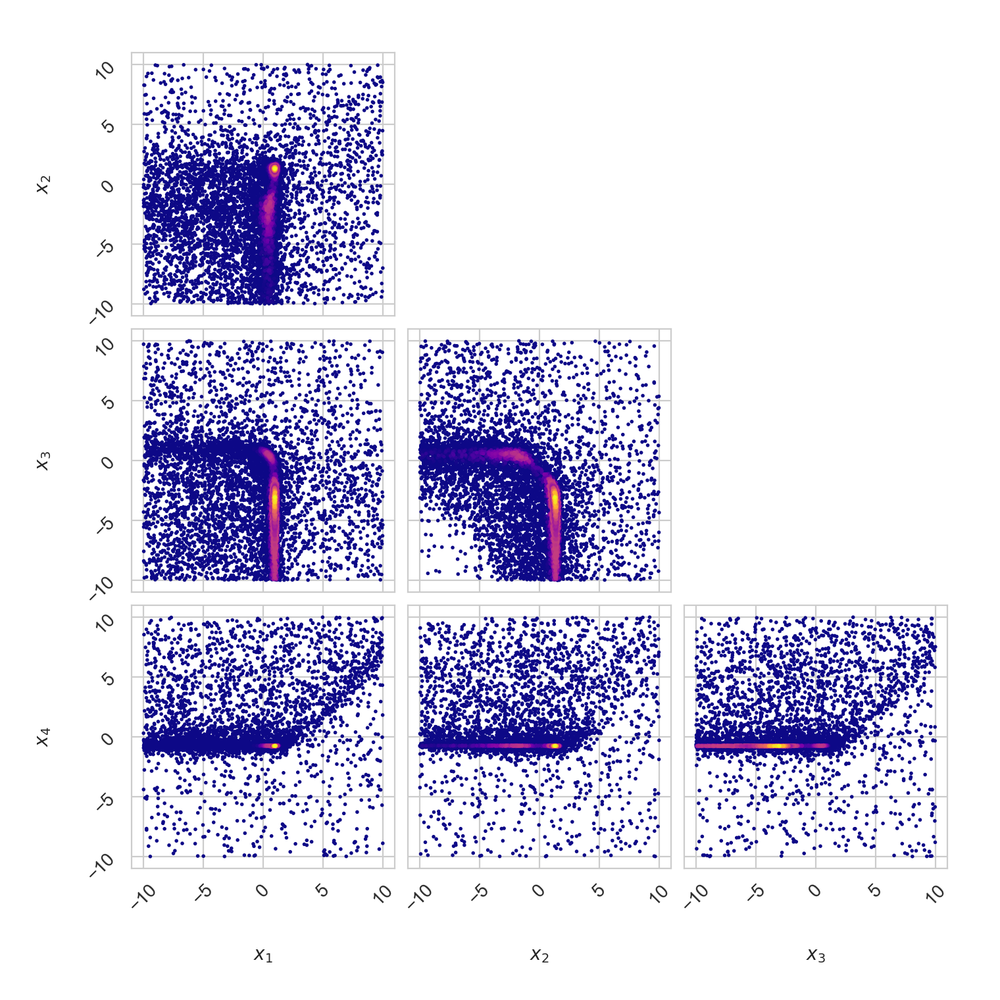

In [53]:
fg, ax = dyplot.cornerpoints(res1, cmap='plasma',
                             kde=False)


In [54]:
new_samples = res1.samples_equal()

<IPython.core.display.Javascript object>


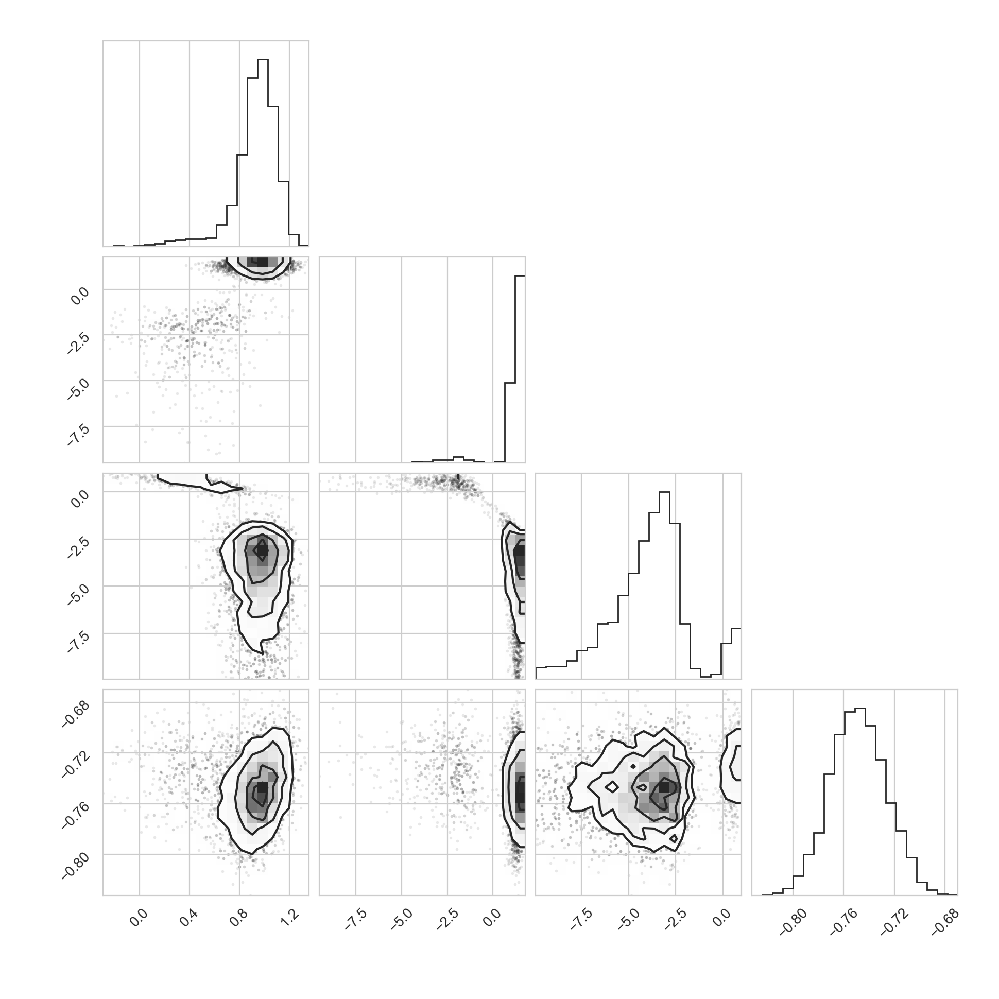

In [55]:
corner.corner(new_samples);

In [56]:
vec_fcoeff2carma_log = np.vectorize(CARMA_term.fcoeffs2carma_log, excluded=[1,],
                                signature="(n)->(m),(k)")
logAR, logMA = vec_fcoeff2carma_log(new_samples, p)
cm30_ns_samples = np.hstack((logAR, logMA))


<IPython.core.display.Javascript object>


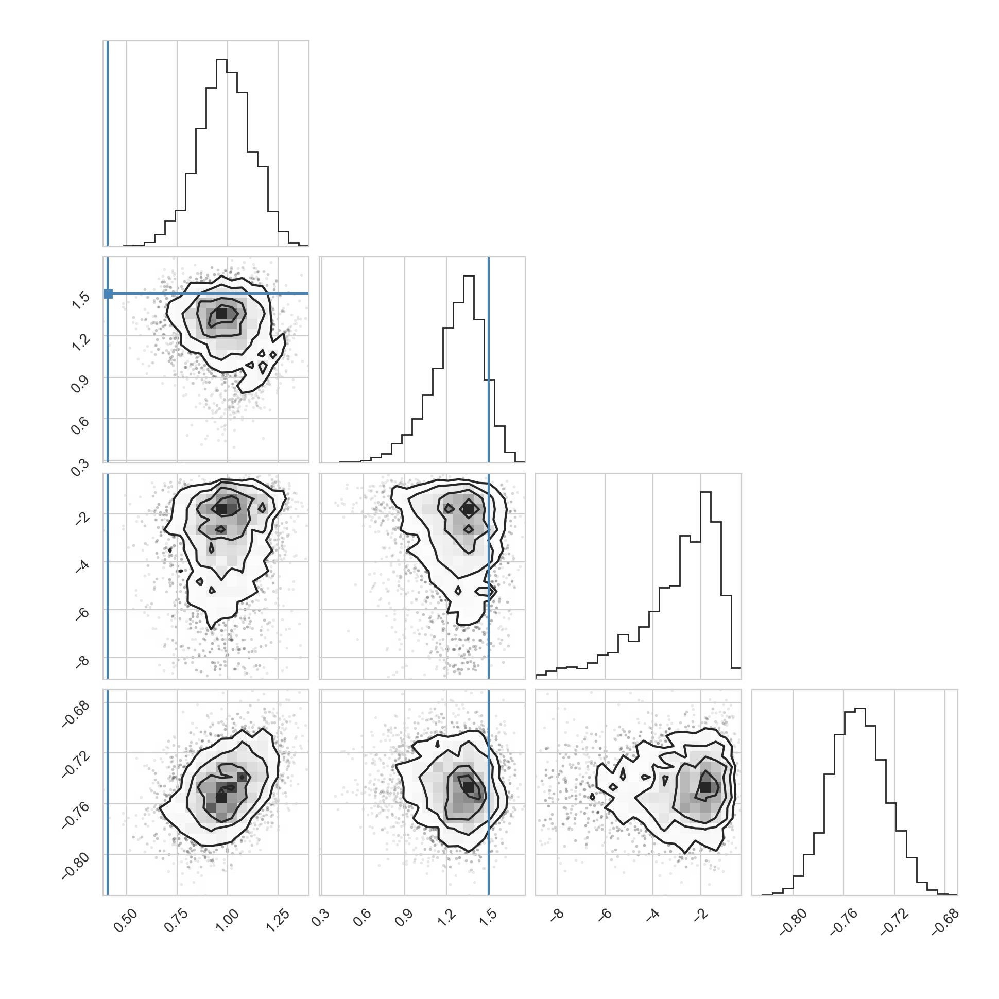

In [58]:
corner.corner(cm30_ns_samples, truths=np.hstack([np.log(alpha), np.log(beta)]));

## With a Mean Model

Let's add a mean model:

In [13]:
from celerite.modeling import Model

# Define the model
class SkewGaussian(Model):
    parameter_names = ("logA", "t0", "logsig1", "logsig2", "logconst")

    def get_value(self, t):
        y = jnp.exp(self.logA) * jnp.where(
                t > self.t0,
                jnp.exp(-((t - self.t0) ** 2) / (2 * (jnp.exp(self.logsig2)**2))),
                jnp.exp(-((t - self.t0) ** 2) / (2 * (jnp.exp(self.logsig1)**2))),
            )
        return y + jnp.exp(self.logconst)



INFO[2023-10-20 14:34:53,569]: Checking if light curve is well behaved. This can take time, so if you are sure it is already sorted, specify skip_checks=True at light curve creation.
INFO[2023-10-20 14:34:53,570]: Checking if light curve is sorted.
INFO[2023-10-20 14:34:53,571]: Computing the bin time ``dt``. This can take time. If you know the bin time, please specify it at light curve creation


<IPython.core.display.Javascript object>


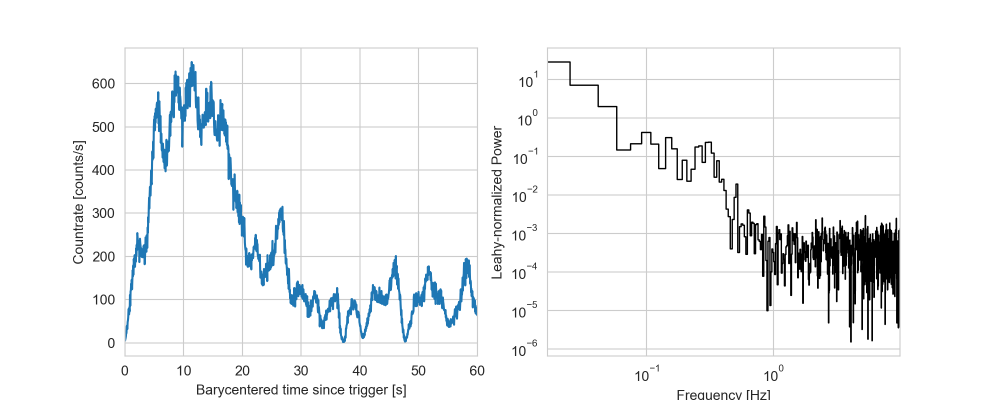

Text(0, 0.5, 'Leahy-normalized Power')

In [28]:
# Make a time array
dt = 0.05
tseg = 60.0

time = np.linspace(0, 60, int(60/0.05))

alpha = [1.5, 4.5, 2.0]
p = len(alpha)
beta = [200.5]
q = len(beta) - 1
sigma = 1.0#10

kernel_params_true = np.hstack([np.log(alpha), np.log(beta)])

skew_amp = 500
skew_t0 = 6.0
skew_sig1 = 2.0
skew_sig2 = 10.0
const = 100.0


mean_params_true = [np.log(skew_amp),
               skew_t0,
               np.log(skew_sig1),
               np.log(skew_sig2),
               np.log(const)]

true_params = np.hstack([mean_params_true, kernel_params_true])

mean_model = SkewGaussian(logA=np.log(skew_amp), 
                          t0 = skew_t0,
                          logsig1 = np.log(skew_sig1),
                          logsig2 = np.log(skew_sig2),
                          logconst = np.log(const))

carma30_kernel = CARMA_term(np.log(alpha), np.log(beta))


gp = celerite.GP(carma30_kernel, mean=mean_model, fit_mean=True)
gp.compute(time)

#key = random.PRNGKey(1200)
#sample = gp.sample()
np.random.seed(100)
sample = gp.sample()

sample = sample.at[sample<0].set(1e-10)
sample = np.random.poisson(sample)

lcsample = Lightcurve(time, sample)
pssample = Powerspectrum(lcsample, norm="frac")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.plot(lcsample.time, lcsample.counts)

ax1.set_xlim(lcsample.time[0], lcsample.time[-1])
ax1.set_xlabel("Barycentered time since trigger [s]")
ax1.set_ylabel("Countrate [counts/s]")

ax2.loglog(pssample.freq, pssample.power, ds="steps-mid", lw=1, color="black")
ax2.set_xlim(pssample.freq[0], pssample.freq[-1])
ax2.set_xlabel("Frequency [Hz]")
ax2.set_ylabel("Leahy-normalized Power")



In [29]:
def neg_fcoeff_ll(params, y, gp):
    """
    Negative log likelihood function for CARMA specified in the factored poly space.

    This method will catch 'overflow/underflow' runtimeWarning and
    return inf as probability.

    Args:
        log_fcoeffs (array(float)): Coefficients (in natural log) of a CARMA model in
            the factored polynomial space.
        y (array(float)): y values of the input time series.
        gp (object): celerite GP object with a proper CARMA kernel.

    Returns:
        float: Negative log likelihood.
    """
    mean_params = params[:gp.mean.vector_size]
    log_fcoeffs = params[gp.mean.vector_size:]

    assert gp.kernel.p >= 2, "Use neg_param_ll() instead!"
    neg_ll = np.inf

    try:
        gp.mean.set_parameter_vector(mean_params)
        gp.kernel.set_log_fcoeffs(log_fcoeffs)
        neg_ll = -gp.log_likelihood(y)
        #print(neg_ll)
    except celerite.solver.LinAlgError as c:
        # print(c)
        pass
    except Exception as e:
        pass

    return neg_ll

def fcoeff_ll(*args):
    return -neg_fcoeff_ll(*args)


In [30]:
true_params

array([6.2146081 , 6.        , 0.69314718, 2.30258509, 4.60517019,
       0.40546511, 1.5040774 , 0.69314718, 5.30081425])

In [31]:
def log_prior(params):
    # skew_gaussian parameters
    log_amp = (params[0] > 0.0) & (params[0] < 8.0)
    t0 = (params[1] > 0) & (params[1] < 10.0)
    log_sig1 = (params[2] > -4) & (params[2] < 2.0)
    log_sig2 = (params[3] > 0.0) & (params[3] < 4.5)
    log_const = (params[4] > 0.0) & (params[4] < 6.0)
    
    # CARMA parameters
    log_alpha1 = (params[5] > -10) & (params[5] < 20)
    log_alpha2 = (params[6] > -10) & (params[6] < 20)
    log_alpha3 = (params[7] > -10) & (params[7] < 20)
    log_beta = (params[8] > -10) & (params[8] < 20)
    
    priors_all = [log_amp, t0, log_sig1, log_sig2, log_const,
                 log_alpha1, log_alpha2, log_alpha3, log_beta]
    
    #print(priors_all)
    
    if np.all(priors_all):
        return np.sum(priors_all)
    else:
        return -np.inf

In [32]:
log_prior(true_params)

9

In [33]:
test_params = [9.21460810e+00,  6.00000000e+00,  6.93147181e-01,  2.30258509e+00,
        4.60517019e+00, -5.55111512e-16,  1.38629436e+00, -6.93147181e-01,
        5.30081425e+00]

log_prior(test_params)

-inf

In [34]:
def log_post(params, y, gp):
    lpr = log_prior(params)
    if not np.isfinite(lpr):
        return lpr
    else:
        return lpr + fcoeff_ll(params, y, gp)

In [35]:


true_fcoeffs = CARMA_term.carma2fcoeffs_log(np.log(alpha), np.log(beta))
true_params = np.hstack([mean_params_true, true_fcoeffs])

model_gp = celerite.GP(carma30_kernel, mean=mean_model, fit_mean=True)
model_gp.compute(time, np.sqrt(lcsample.counts))


In [36]:
import emcee

ndim, nwalkers = len(true_params), 32
sampler_cm30 = emcee.EnsembleSampler(nwalkers, ndim, log_post, args=[lcsample.counts, model_gp])

print("Running burn-in...")
p0 = true_params + 1e-5 * np.random.randn(nwalkers, ndim)
p0, lp, _ = sampler_cm30.run_mcmc(p0, 500)


Running burn-in...


In [37]:
print("Running production...")
sampler_cm30.reset()
sampler_cm30.run_mcmc(p0, 4000);


Running production...


<IPython.core.display.Javascript object>


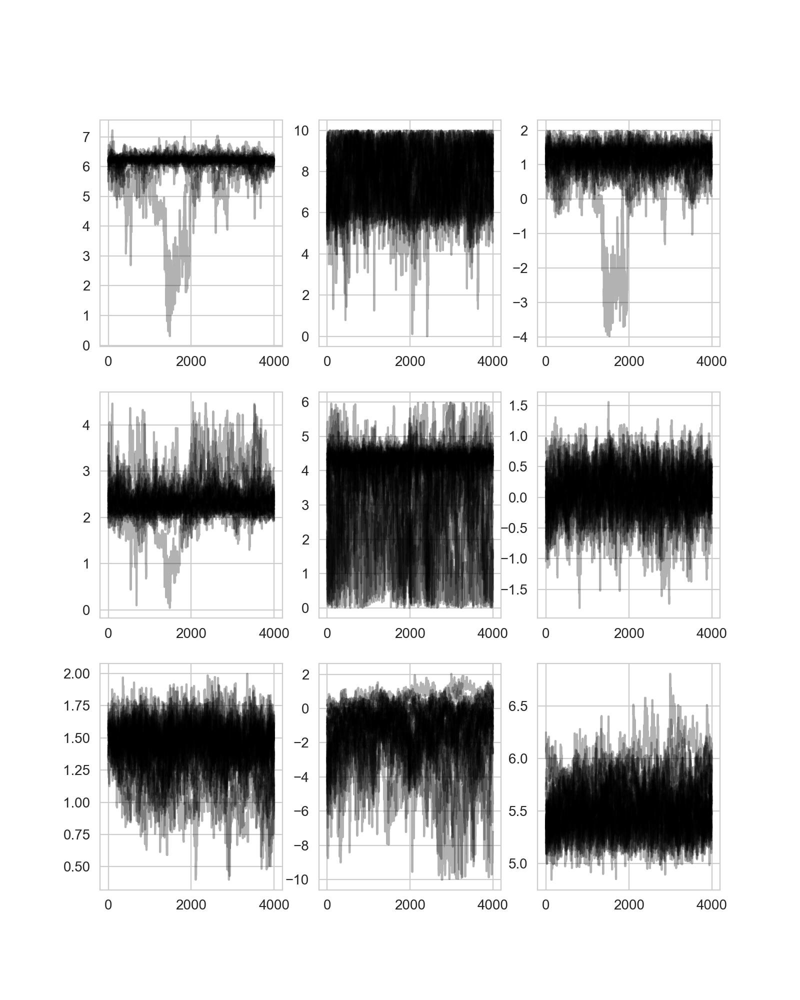

In [38]:
fig, axes = plt.subplots(3, 3, figsize=(8,10))

axes = np.hstack(axes)

for i in range(sampler_cm30.chain.shape[-1]):
    
    chain = sampler_cm30.chain[:,:,i]
    
    axes[i].plot(chain.T, color="black", alpha=0.3)

<IPython.core.display.Javascript object>


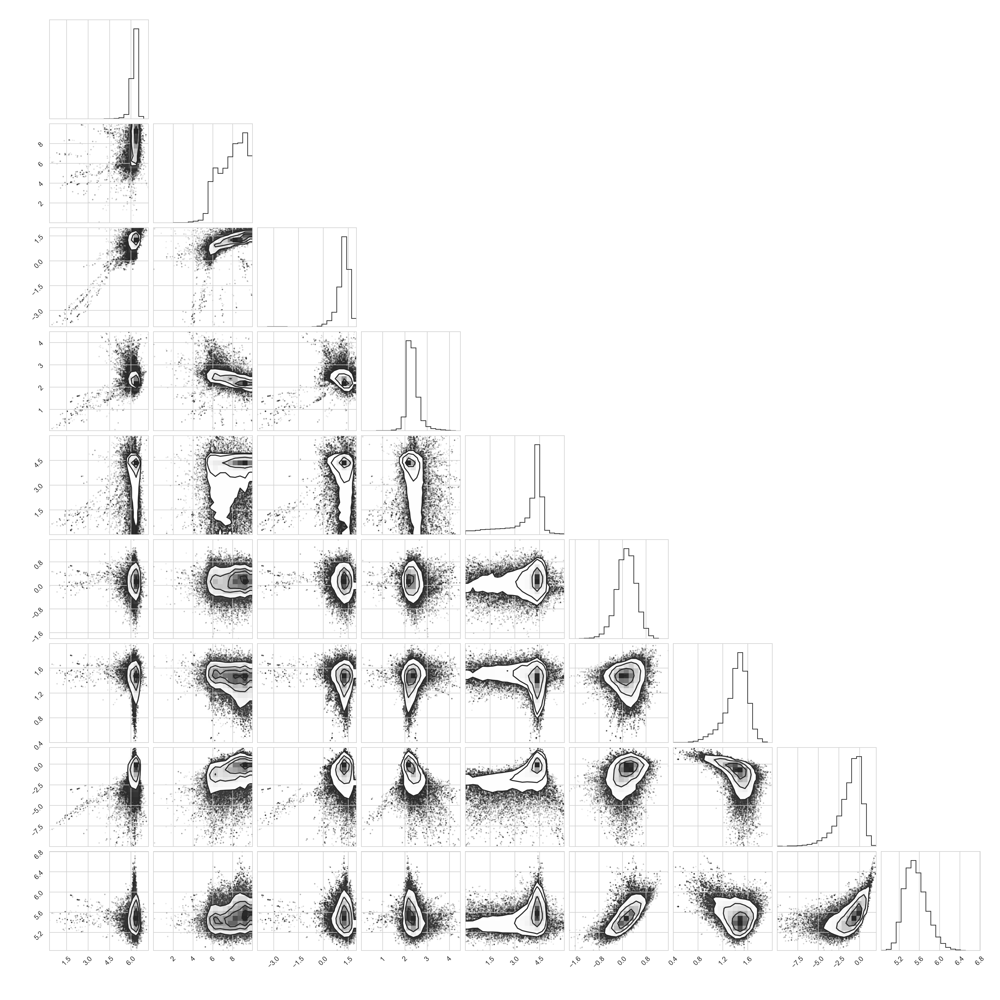

WARNING[2023-10-20 14:39:39,263]: Too few points to create valid contours
WARNING[2023-10-20 14:39:39,365]: Too few points to create valid contours


In [39]:
corner.corner(sampler_cm30.flatchain,
              title_kwargs={"fontsize": 12});


In [40]:
# from the polynomial space to CARMA space
vec_fcoeff2carma_log = np.vectorize(CARMA_term.fcoeffs2carma_log, excluded=[1,],
                                signature="(n)->(m),(k)")
logAR, logMA = vec_fcoeff2carma_log(sampler_cm30.flatchain[:,model_gp.mean.vector_size:], p)
cm30_flatchain = np.hstack((logAR, logMA))


In [41]:
cm30_flatchain.shape

(128000, 4)

In [42]:
cm30_flatchain = np.hstack([sampler_cm30.flatchain[:, :model_gp.mean.vector_size], cm30_flatchain])

<IPython.core.display.Javascript object>


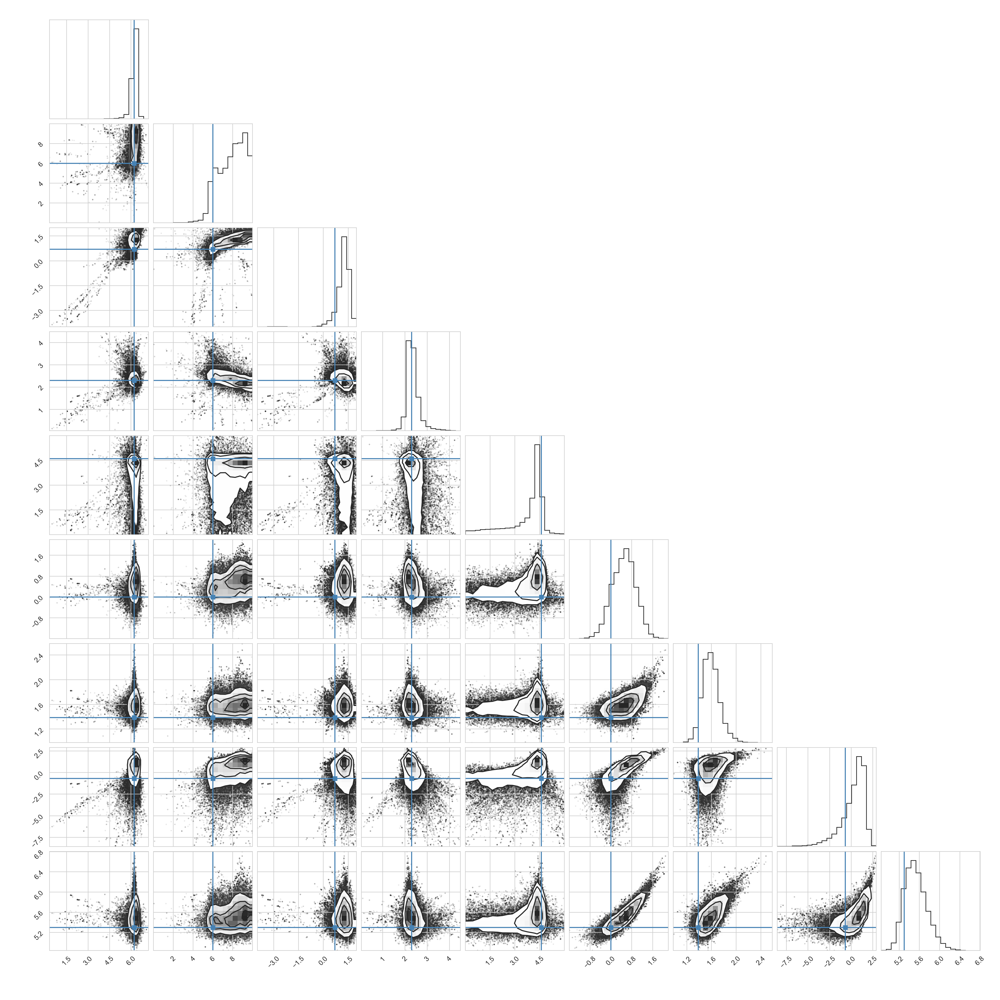

WARNING[2023-10-20 14:45:44,482]: Too few points to create valid contours
WARNING[2023-10-20 14:45:44,580]: Too few points to create valid contours


In [43]:
corner.corner(cm30_flatchain, truths=true_params,
              title_kwargs={"fontsize": 12});


### Nested Sampling

Let's do the same again with Nested Sampling:

In [44]:
import dynesty

In [45]:
true_params

array([ 6.21460810e+00,  6.00000000e+00,  6.93147181e-01,  2.30258509e+00,
        4.60517019e+00, -5.55111512e-16,  1.38629436e+00, -6.93147181e-01,
        5.30081425e+00])

In [78]:

def prior_transform(u):
    """Transforms the uniform random variable `u ~ Unif[0., 1.)`
    to the parameter of interest `x ~ Unif[-10., 10.)`."""
    
    log_amp = u[0]
    t0 = u[1]
    log_sig1 = u[2]
    log_sig2 = u[3]
    log_const = u[4]
    
    log_alpha1 = u[5]
    log_alpha2 = u[6]
    log_alpha3 = u[7]
    log_beta = u[8]

    x_logamp = 3 * log_amp + 4.5 # scale and shift to [4.5, 7.5]
    
    x_t0 = 10 * t0 # scale t0 [0, 10]
    
    x_logsig1 = 6 * log_sig1 - 3.0 # scale and shift to [3, 3]
    
    x_logsig2 = 4 * log_sig2 # scale to [0, 4]
    
    x_logconst = 3 * log_const + 3.0 # scale and shift to [2, 6]
    
    
    x_alpha1 = 2. * log_alpha1 - 1.  # scale and shift to [-1., 1.)
    x_alpha1 *= 5.  # scale to [-10., 10.)

    x_alpha2 = 2. * log_alpha2 - 1.  # scale and shift to [-1., 1.)
    x_alpha2 *= 5.  # scale to [-10., 10.)

    x_alpha3 = 2. * log_alpha3 - 1.  # scale and shift to [-1., 1.)
    x_alpha3 *= 5.  # scale to [-10., 10.)

    x_beta = 10 * log_beta   # scale and shift to [-1., 1.)
    #x_beta *= 10.  # scale to [-10., 10.)

    x = np.array([x_logamp, x_t0, x_logsig1, x_logsig2, x_logconst,
                  x_alpha1, x_alpha2, x_alpha3, x_beta])
    return x


In [79]:
nsim = 10000

x_all = []
for i in range(nsim):
    
    x_all.append(prior_transform(np.random.uniform(0, 1, size=model_gp.vector_size)))
    
x_all = np.array(x_all)

<IPython.core.display.Javascript object>


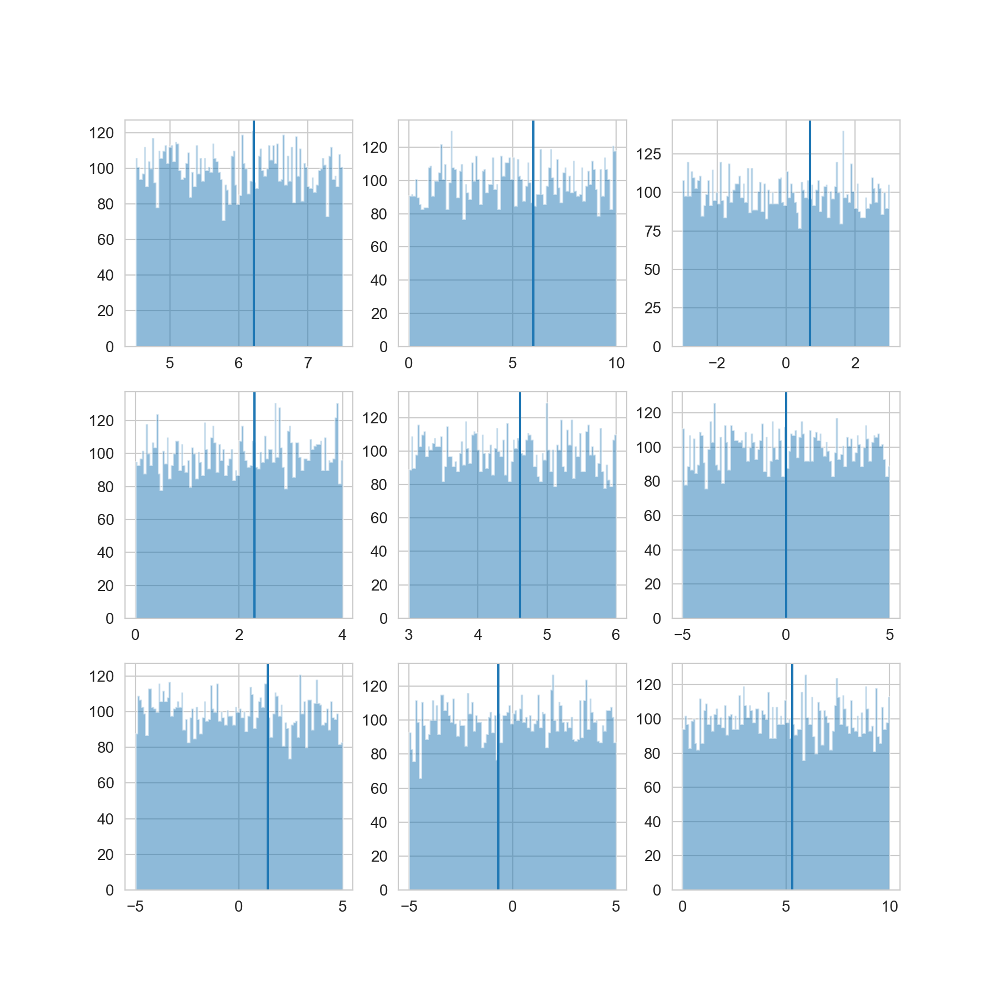

In [80]:
fig, axes = plt.subplots(3, 3, figsize=(9,9))

axes = np.hstack(axes)

for i in range(model_gp.vector_size):
    axes[i].hist(x_all[:,i], bins=100, histtype="stepfilled", alpha=0.5)
    axes[i].axvline(true_params[i])

In [82]:
from dynesty import DynamicNestedSampler

In [85]:
sampler = DynamicNestedSampler(fcoeff_ll, prior_transform, ndim, 
                               logl_args=(lcsample.counts, model_gp), sample="rwalk")

In [86]:
sampler.run_nested()

18635it [11:36, 26.74it/s, batch: 2 | bound: 7 | nc: 1 | ncall: 479273 | eff(%):  3.778 | loglstar: -4944.716 < -4937.303 < -4943.406 | logz: -4959.620 +/-  0.165 | stop:  0.970]       


In [87]:
res1 = sampler.results

In [88]:
res1.summary()

Summary
niter: 18635
ncall: 465273
eff(%):  3.778
logz: -4959.575 +/-  0.159


In [89]:
from dynesty import plotting as dyplot

<IPython.core.display.Javascript object>


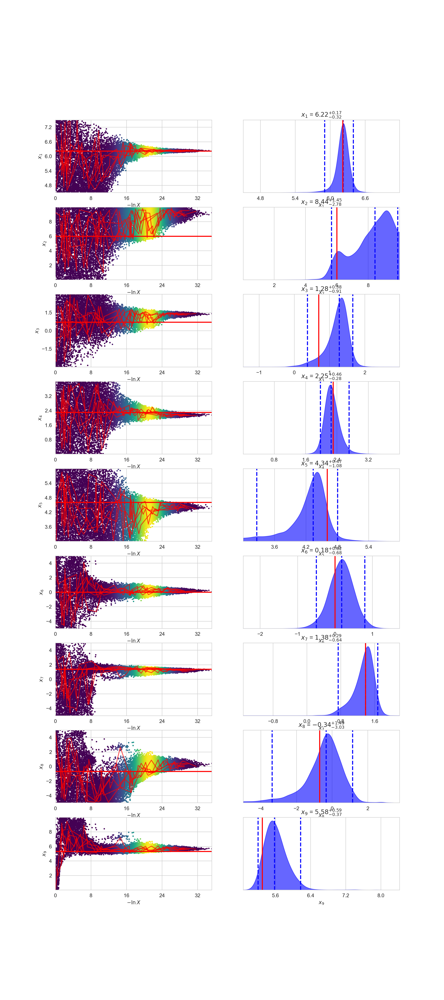

In [90]:

fig, axes = dyplot.traceplot(res1,show_titles=True, truths=true_params,
                             trace_cmap='viridis', connect=True,
                             connect_highlight=range(5))


It works! Hooray!

## Modeling the Real Data

To load the data, we'll have to read them from an IDL .sav file, which will return a dictionary with the relevant columns as keywords and the values in arrays:

In [91]:
#datadir = "/Users/danielahuppenkothen/work/repositories/grb230307a_qposearch/data/"
datadir = "/Users/daniela/work/data/grb230307A/"

data = scipy.io.readsav(datadir+"acs_lc_bary.sav")
data

{'barytime': array([-6.87185967, -6.82185948, -6.77185976, ..., 98.02814186,
        98.07813728, 98.12814033], dtype='>f8'),
 'counts': array([4502., 4570., 4576., ..., 4516., 4444., 4514.], dtype='>f4')}

In [92]:
barytime = np.array(data["barytime"], dtype=float)
counts = np.array(data["counts"], dtype=float)

# calculate background flux
mean_bkg = np.mean(counts[-100:])
print(mean_bkg)

# store in Lightcurve object, then truncate to 0-60s interval:
lc = Lightcurve(barytime, counts)# -mean_bkg)
minind = lc.time.searchsorted(0.0)
maxind = lc.time.searchsorted(60.0)
lc = lc.truncate(start=minind, stop=maxind, method="index")

# calculate periodogram for comparison:
ps = Powerspectrum(lc, norm="leahy")

INFO[2023-10-20 16:16:17,411]: Checking if light curve is well behaved. This can take time, so if you are sure it is already sorted, specify skip_checks=True at light curve creation.
INFO[2023-10-20 16:16:17,413]: Checking if light curve is sorted.
INFO[2023-10-20 16:16:17,414]: Computing the bin time ``dt``. This can take time. If you know the bin time, please specify it at light curve creation


4569.8


<IPython.core.display.Javascript object>


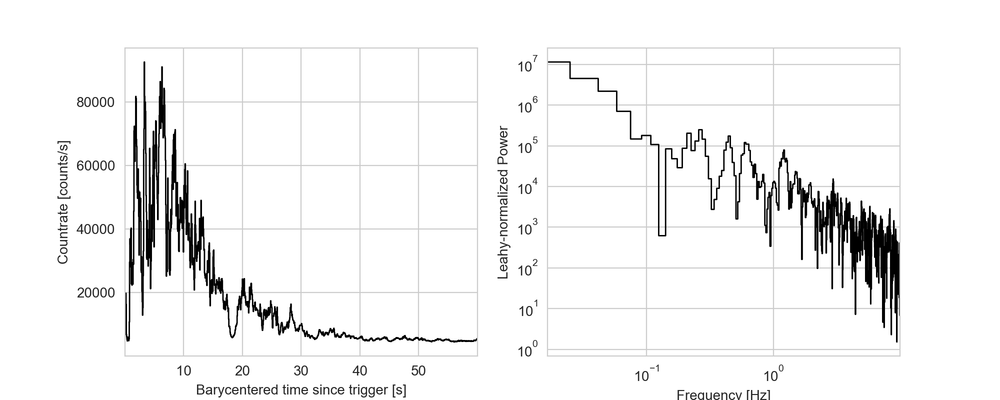

Text(0, 0.5, 'Leahy-normalized Power')

In [93]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.plot(lc.time, lc.counts, lw=1, color="black", ds="steps-mid")
ax1.set_xlim(lc.time[0], lc.time[-1])
ax1.set_xlabel("Barycentered time since trigger [s]")
ax1.set_ylabel("Countrate [counts/s]")

ax2.loglog(ps.freq, ps.power, ds="steps-mid", lw=1, color="black")
ax2.set_xlim(ps.freq[0], ps.freq[-1])
ax2.set_xlabel("Frequency [Hz]")
ax2.set_ylabel("Leahy-normalized Power")

Let's set up the Dynamic Nested Sampler:

In [146]:
def loglike_carma30(params, y, gp):
    """
    Negative log likelihood function for CARMA specified in the factored poly space.

    This method will catch 'overflow/underflow' runtimeWarning and
    return inf as probability.

    Args:
        log_fcoeffs (array(float)): Coefficients (in natural log) of a CARMA model in
            the factored polynomial space.
        y (array(float)): y values of the input time series.
        gp (object): celerite GP object with a proper CARMA kernel.

    Returns:
        float: Negative log likelihood.
    """
    mean_params = params[:gp.mean.vector_size]
    log_fcoeffs = params[gp.mean.vector_size:]

    #assert gp.kernel.p >= 2, "Use neg_param_ll() instead!"
    loglike = -np.inf

    try:
        gp.mean.set_parameter_vector(mean_params)
        gp.kernel.set_log_fcoeffs(log_fcoeffs)
        loglike = gp.log_likelihood(y)
        #print(neg_ll)
    except celerite.solver.LinAlgError as c:
        # print(c)
        pass
    except Exception as e:
        pass

    return loglike


def carma30_prior_transform(u):
    """Transforms the uniform random variable `u ~ Unif[0., 1.)`
    to the parameter of interest `x ~ Unif[-10., 10.)`."""
    
    log_amp = u[0]
    t0 = u[1]
    log_sig1 = u[2]
    log_sig2 = u[3]
    log_const = u[4]
    
    log_alpha1 = u[5]
    log_alpha2 = u[6]
    log_alpha3 = u[7]
    log_beta = u[8]

    x_logamp = 3 * log_amp + 9 # scale and shift to [9, 12]
    
    x_t0 = 10 * t0 # scale t0 [0, 10]
    
    x_logsig1 = 6 * log_sig1 - 4.0 # scale and shift to [-4, 2]
    
    x_logsig2 = 4 * log_sig2 # scale to [0, 4]
    
    # mean(lc.counts[-100:] = 8.468208808387544
    x_logconst = 3 * log_const + 7.0 # scale and shift to [7, 10]
    
    
    x_alpha1 = 2. * log_alpha1 - 1.  # scale and shift to [-1., 1.)
    x_alpha1 *= 10.  # scale to [-10., 10.)

    x_alpha2 = 2. * log_alpha2 - 1.  # scale and shift to [-1., 1.)
    x_alpha2 *= 10.  # scale to [-10., 10.)

    x_alpha3 = 2. * log_alpha3 - 1.  # scale and shift to [-1., 1.)
    x_alpha3 *= 10.  # scale to [-10., 10.)

    x_beta = 15 * log_beta + 3   # scale and shift to [-1., 1.)
    #x_beta *= 10.  # scale to [-10., 10.)

    x = np.array([x_logamp, x_t0, x_logsig1, x_logsig2, x_logconst,
                  x_alpha1, x_alpha2, x_alpha3, x_beta])
    return x


In [113]:
carma30_kernel = CARMA_term(np.log(alpha), np.log(beta))

model_gp = celerite.GP(carma30_kernel, mean=mean_model, fit_mean=True)
model_gp.compute(time, np.sqrt(lc.counts))

In [114]:
sampler = DynamicNestedSampler(loglike_carma30, carma30_prior_transform, ndim, 
                               logl_args=(lc.counts, model_gp), sample="rwalk")
sampler.run_nested()

27956it [12:05, 38.56it/s, batch: 3 | bound: 48 | nc: 1 | ncall: 749906 | eff(%):  3.660 | loglstar: -11585.038 < -11575.849 < -11577.635 | logz: -11610.731 +/-  0.199 | stop:  0.787]     


In [115]:
res1 = sampler.results
res1.summary()

Summary
niter: 27956
ncall: 721906
eff(%):  3.660
logz: -11610.656 +/-  0.168


In [116]:
import pickle
with open(datadir + "integral_carma31_eztao_ns.pkl", "wb") as f:
    pickle.dump(res1, f)

In [117]:
carma30_labels = ["log_amp", "t0", "log_sig1", "log_sig2", "log_const", 
          "log_alpha1", "log_alpha2", "log_alpha3", "log_beta"]

<IPython.core.display.Javascript object>


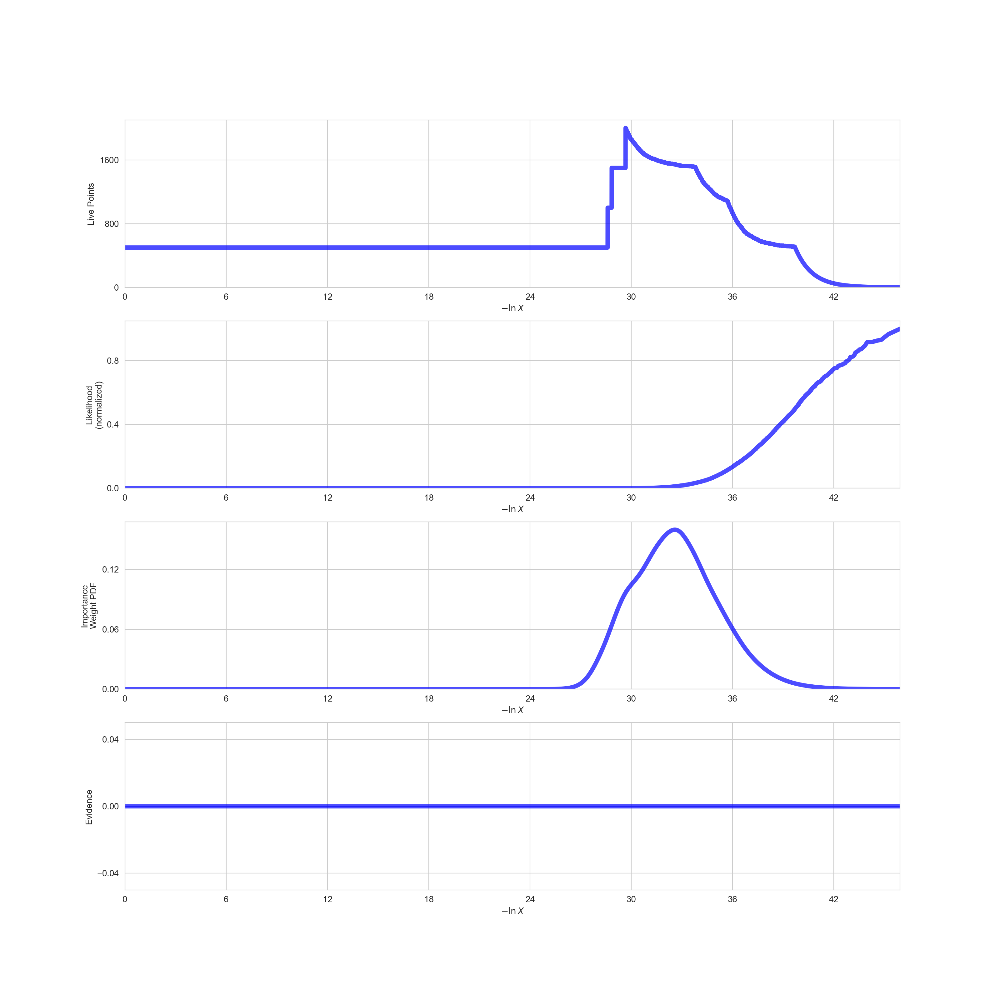

In [120]:
fig, axes = dyplot.runplot(res1)

<IPython.core.display.Javascript object>


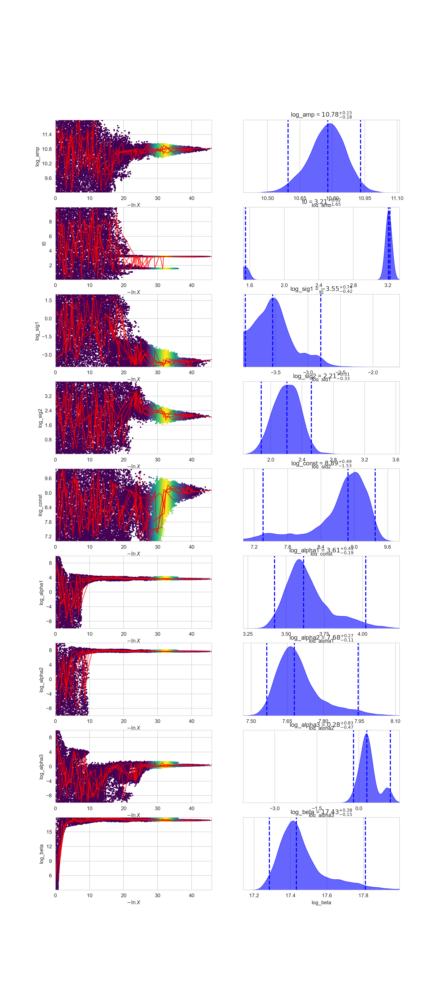

In [118]:
#fig = plt.figure(figsize=(9, 10))
fig, axes = dyplot.traceplot(res1,show_titles=True, labels=carma30_labels,
                             trace_cmap='viridis', connect=True,
                             connect_highlight=range(5), )


<IPython.core.display.Javascript object>


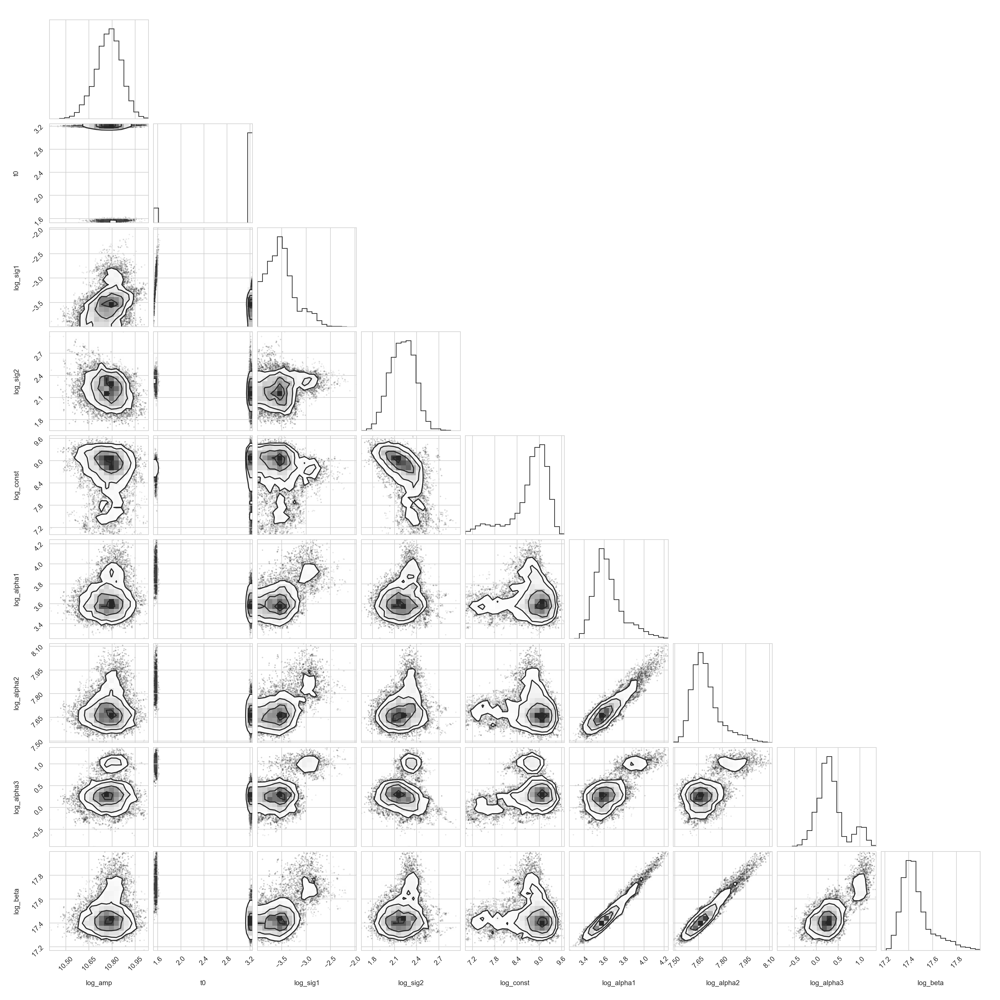

In [124]:
samples = res1.samples_equal()

corner.corner(samples, labels=carma30_labels);

Let's include a function to compute the PSD:

In [125]:
def power_spectrum(freq, sigma, ar_coef, ma_coefs=[1.0]):
    """
    FROM CARMApack (Kelly et al, 2014)
    
    Return the power spectrum for a CARMA(p,q) process calculated at the input frequencies.

    :param freq: The frequencies at which to calculate the PSD.
    :param sigma: The standard deviation driving white noise.
    :param ar_coef: The CARMA model autoregressive coefficients.
    :param ma_coefs: Coefficients of the moving average polynomial

    :rtype : The power spectrum at the input frequencies, a numpy array.
    """
    try:
        len(ma_coefs) <= len(ar_coef)
    except ValueError:
        "Size of ma_coefs must be less or equal to size of ar_roots."

    ma_poly = np.polyval(ma_coefs[::-1], 2.0 * np.pi * 1j * freq)  # Evaluate the polynomial in the PSD numerator
    ar_poly = np.polyval(ar_coef, 2.0 * np.pi * 1j * freq)  # Evaluate the polynomial in the PSD denominator
    pspec = sigma ** 2 * np.abs(ma_poly) ** 2 / np.abs(ar_poly) ** 2
    return pspec

In [127]:
samples.shape

(27956, 9)

In [128]:
model_gp.mean.set_parameter_vector

['log_amp',
 't0',
 'log_sig1',
 'log_sig2',
 'log_const',
 'log_alpha1',
 'log_alpha2',
 'log_alpha3',
 'log_beta']

In [131]:
def skewgaussian(t, params):
    #parameter_names = ("logA", "t0", "logsig1", "logsig2", "logconst")
    logA = params[0]
    t0 = params[1]
    logsig1 = params[2]
    logsig2 = params[3]
    logconst = params[4]

    y = jnp.exp(logA) * jnp.where(
            t > t0,
            jnp.exp(-((t - t0) ** 2) / (2 * (jnp.exp(logsig2)**2))),
            jnp.exp(-((t - t0) ** 2) / (2 * (jnp.exp(logsig1)**2))),
        )
    return y + jnp.exp(logconst)

<IPython.core.display.Javascript object>


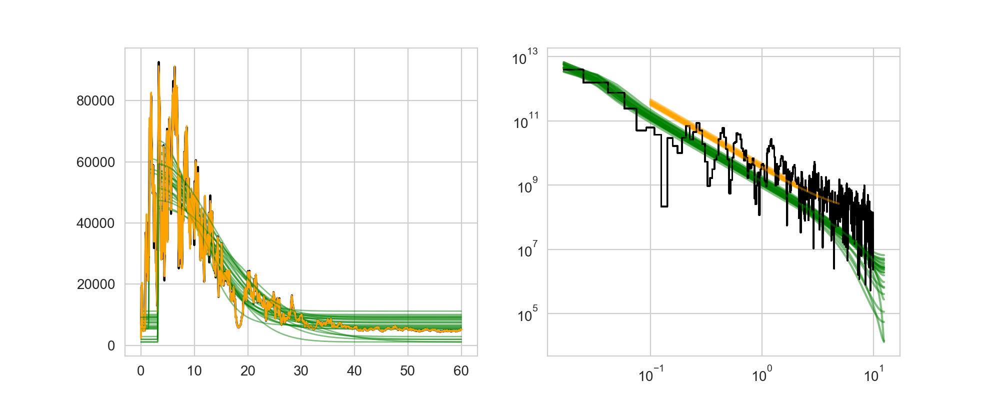

In [141]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.plot(lc.time, lc.counts, color="black")

np.random.seed(1000)
nsims = 25 # number of simulated light curves / PSDs
nsamples = samples[:,5].shape[0] 
idx_all = np.random.choice(np.arange(0, nsamples, 1, dtype=int), size=nsims, replace=False)

# time array for the posterior predictive examples
tpost = np.linspace(0.0, time[-1], 1500)
dt_post = tpost[1] - tpost[0]

# frequencies for the PSD
freq = np.fft.fftfreq(lc.n, d=lc.dt)
freq = freq[:int(lc.n/2)]
# calculate periodogram for comparison:
ps = Powerspectrum(lc, norm="abs")

for idx in idx_all:
    # mean parameters
    params = [samples[:,0][idx],
              samples[:,1][idx],
              samples[:,2][idx],
              samples[:,3][idx],
              samples[:,4][idx]]
    
    mean_post = skewgaussian(tpost, params)
    
    # kernel parameters
    log_alpha_post = [samples[:,5][idx],
                      samples[:,6][idx], 
                      samples[:,7][idx]]
    
    log_beta_post = [samples[:,8][idx]]
    #sigma_post = jnp.exp(samples["log_sigma"][idx])

    post_kernel = CARMA_term(log_alpha_post, log_beta_post)

    mean_model = SkewGaussian(*params)
    post_gp = celerite.GP(post_kernel, mean=mean_model, fit_mean=True)

    post_gp.compute(lc.time, np.sqrt(lc.counts))
    
    #kernel_post = CARMA.init(alpha=alpha_post, 
    #                    beta=beta_post, 
    #                    sigma=sigma_post)
    

    mu, var = post_gp.predict(lc.counts, tpost, return_var=True)
    #_, cond = post_gp.condition(lc.counts[:npoints], tpost, include_mean=True)

    ax1.plot(tpost, mu, lw=1, color="orange", alpha=0.4)
    ax1.plot(tpost, mean_post, lw=1, color="green", alpha=0.5)
    
    #psd = power_spectrum(freq, sigma_post, alpha_post, ma_coefs=[beta_post])
    
    freq = np.arange(0.1, 5.0, 0.1)
    psd = post_kernel.get_psd(2.*np.pi*freq) * len(lc.counts)
    
    ps_mean = Powerspectrum(Lightcurve(tpost, mean_post, dt=dt_post, skip_checks=True), norm="abs")
    
    ax2.loglog(ps.freq, ps.power, lw=1, color="black", ds="steps-mid")
    ax2.loglog(freq, psd, color="orange", alpha=0.4)
    ax2.loglog(ps_mean.freq, ps_mean.power, color="green", alpha=0.5)



## A model with a QPO

Let's now add a model with a QPO:

In [233]:
def loglike_carma30_qpo(params, y, gp):
    """
    Negative log likelihood function for CARMA specified in the factored poly space.

    This method will catch 'overflow/underflow' runtimeWarning and
    return inf as probability.

    Args:
        log_fcoeffs (array(float)): Coefficients (in natural log) of a CARMA model in
            the factored polynomial space.
        y (array(float)): y values of the input time series.
        gp (object): celerite GP object with a proper CARMA kernel.

    Returns:
        float: Negative log likelihood.
    """
    mean_params = params[:gp.mean.vector_size]
    log_fcoeffs = params[gp.mean.vector_size:-3]
    qpo_params = params[-3:]

    #assert gp.kernel.p >= 2, "Use neg_param_ll() instead!"
    loglike = -np.inf

    try:
        gp.mean.set_parameter_vector(mean_params)
        gp.kernel.terms[0].set_log_fcoeffs(log_fcoeffs)
        gp.kernel.terms[1].set_parameter_vector(qpo_params)
        loglike = gp.log_likelihood(y)
    except celerite.solver.LinAlgError as c:
        pass
    except Exception as e:
        print("Other Exception?")
        pass

    return loglike

def carma30_qpo_prior_transform(u):
    """Transforms the uniform random variable `u ~ Unif[0., 1.)`
    to the parameter of interest `x ~ Unif[-10., 10.)`."""
    
    log_amp = u[0]
    t0 = u[1]
    log_sig1 = u[2]
    log_sig2 = u[3]
    log_const = u[4]
    
    log_alpha1 = u[5]
    log_alpha2 = u[6]
    log_alpha3 = u[7]
    log_beta = u[8]
    
    log_qpo_amp = u[9]
    log_freq = u[10]
    log_quality = u[11]

    x_logamp = 3 * log_amp + 9 # scale and shift to [9, 12]
    
    x_t0 = 10 * t0 # scale t0 [0, 10]
    
    x_logsig1 = 6 * log_sig1 - 4.0 # scale and shift to [-4, 2]
    
    x_logsig2 = 4 * log_sig2 # scale to [0, 4]
    
    # mean(lc.counts[-100:] = 8.468208808387544
    x_logconst = 3 * log_const + 7.0 # scale and shift to [7, 10]
    
    
    x_alpha1 = 2. * log_alpha1 - 1.  # scale and shift to [-1., 1.)
    x_alpha1 *= 10.  # scale to [-10., 10.)

    x_alpha2 = 2. * log_alpha2 - 1.  # scale and shift to [-1., 1.)
    x_alpha2 *= 10.  # scale to [-10., 10.)

    x_alpha3 = 2. * log_alpha3 - 1.  # scale and shift to [-1., 1.)
    x_alpha3 *= 10.  # scale to [-10., 10.)

    x_beta = 15 * log_beta + 3   # scale and shift to [-1., 1.)
    #x_beta *= 10.  # scale to [-10., 10.)

    x_log_qpo_amp = 3 * log_qpo_amp + 9 # scale and shift to [9, 12]

    x_log_omega = (np.log(5.0*2*np.pi) - np.log(2*np.pi*0.1)) * log_freq + np.log(2*np.pi*0.1)
    
    x_log_quality = (np.log(50) - np.log(5.0)) * log_quality + np.log(5.0)
    
    x = np.array([x_logamp, x_t0, x_logsig1, x_logsig2, x_logconst,
                  x_alpha1, x_alpha2, x_alpha3, x_beta,
                  x_log_qpo_amp, x_log_omega, x_log_quality])
    return x


In [234]:
posterior_means = np.mean(samples, axis=0)
post_mean_pars = posterior_means[:5]
post_kernel_pars = posterior_means[5:]

log_qpo_amp = 10.0
log_quality = np.log(10.0)
log_omega = np.log(2.*np.pi*0.8)

carma30_kernel = CARMA_term(post_kernel_pars[:p], post_kernel_pars[p:])
sho_kernel = celerite.terms.SHOTerm(log_S0=log_qpo_amp, log_Q=log_quality, log_omega0=log_omega)

carma30_qpo_kernel = carma30_kernel + sho_kernel

mean_model = SkewGaussian(*post_mean_pars)

model_qpo_gp = celerite.GP(carma30_qpo_kernel, mean=mean_model, fit_mean=True)
model_qpo_gp.compute(lc.time, np.sqrt(lc.counts))


In [235]:
test_params = np.hstack([np.mean(samples, axis=0), log_qpo_amp, log_omega, log_quality])

loglike_carma30_qpo(test_params, lc.counts, model_qpo_gp)


-11672.988379346421

In [236]:
ndim_qpo = model_qpo_gp.vector_size

sampler_qpo = DynamicNestedSampler(loglike_carma30_qpo, carma30_qpo_prior_transform, ndim_qpo, 
                               logl_args=(lc.counts, model_qpo_gp), sample="rwalk")
sampler_qpo.run_nested(nlive_init=1000)

50240it [26:16, 31.87it/s, batch: 0 | bound: 321 | nc: 1 | ncall: 1497226 | eff(%):  3.356 | loglstar:   -inf < -11564.819 <    inf | logz: -11609.430 +/-    nan | dlogz:  0.000 >  0.010] 


In [237]:
res_qpo = sampler_qpo.results
res_qpo.summary()

Summary
niter: 50240
ncall: 1497226
eff(%):  3.356
logz: -11609.430 +/-  0.200


In [238]:
import pickle
with open(datadir + "integral_carma31_qpo_eztao_ns.pkl", "wb") as f:
    pickle.dump(res_qpo, f)

In [239]:
carma30_qpo_labels = ["log_amp", "t0", "log_sig1", "log_sig2", "log_const", 
          "log_alpha1", "log_alpha2", "log_alpha3", "log_beta",
                 "log_qpo_amp", "log_omega", "log_quality"]

<IPython.core.display.Javascript object>


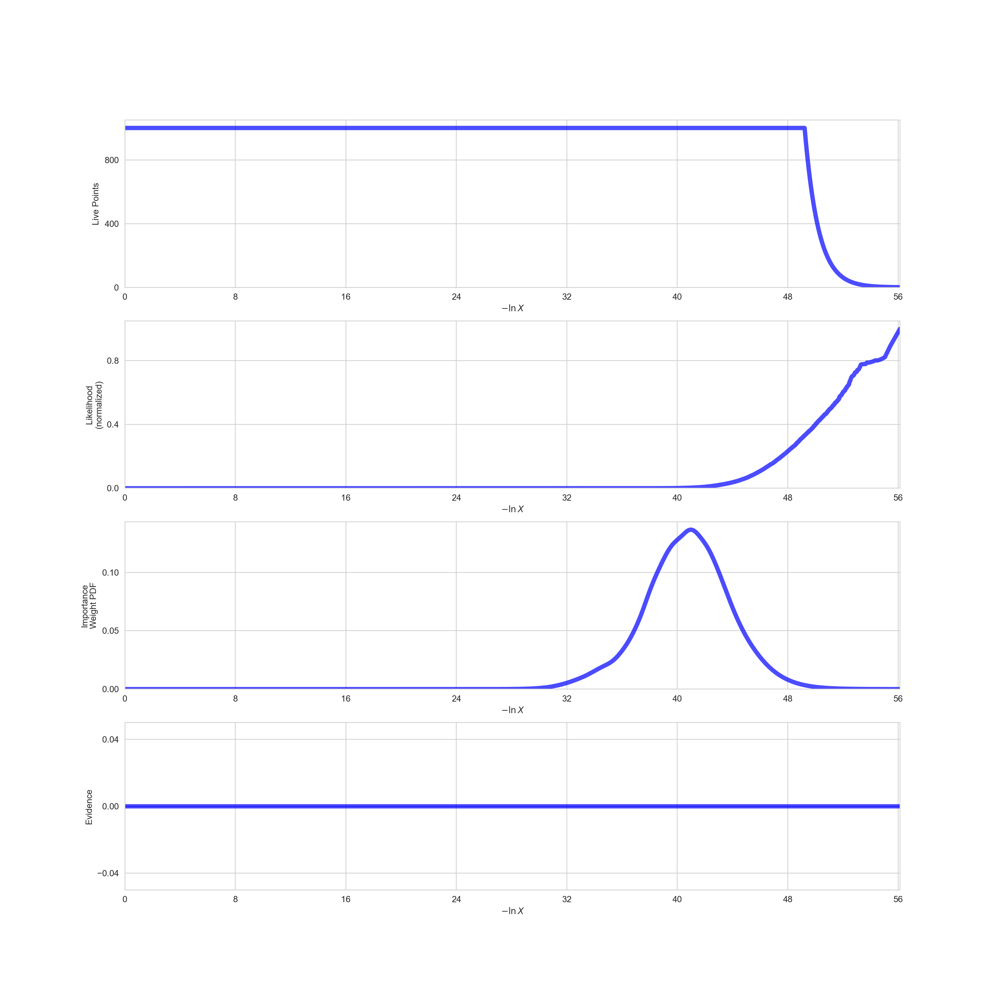

In [240]:
fig, axes = dyplot.runplot(res_qpo)

<IPython.core.display.Javascript object>


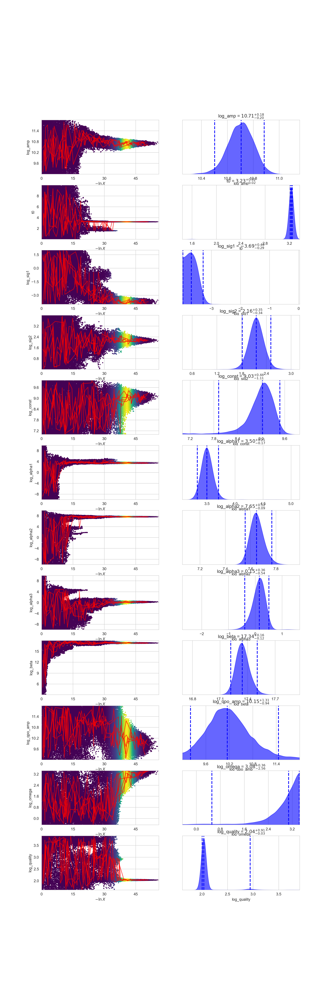

In [242]:
#fig = plt.figure(figsize=(9, 10))
fig, axes = dyplot.traceplot(res_qpo,show_titles=True, labels=carma30_qpo_labels,
                             trace_cmap='viridis', connect=True,
                             connect_highlight=range(5), )


<IPython.core.display.Javascript object>


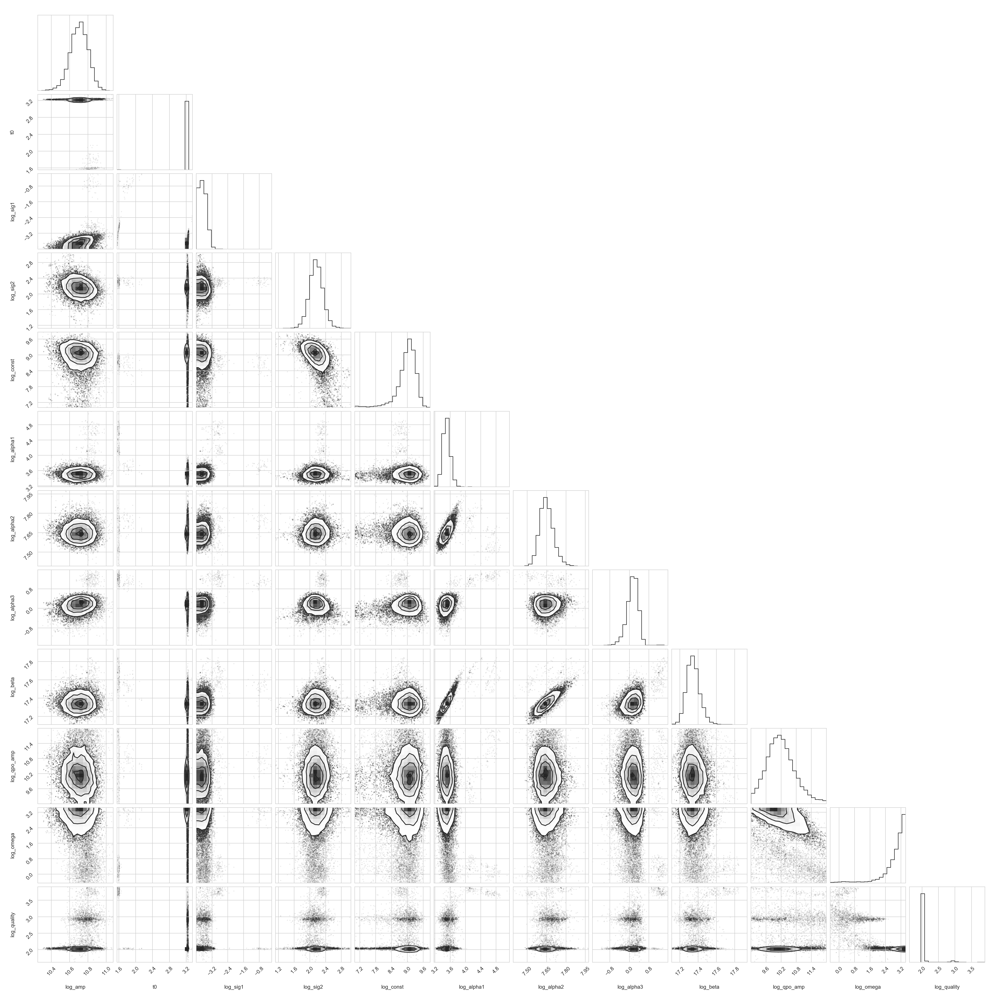

WARNING[2023-10-21 16:01:46,985]: Too few points to create valid contours
WARNING[2023-10-21 16:01:47,074]: Too few points to create valid contours
WARNING[2023-10-21 16:01:47,205]: Too few points to create valid contours
WARNING[2023-10-21 16:01:47,403]: Too few points to create valid contours
WARNING[2023-10-21 16:01:47,591]: Too few points to create valid contours
WARNING[2023-10-21 16:01:48,009]: Too few points to create valid contours
WARNING[2023-10-21 16:01:48,283]: Too few points to create valid contours
WARNING[2023-10-21 16:01:48,871]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,227]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,266]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,306]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,380]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,414]: Too few points to create valid contours
WARNING[2023-10-21 16:01:49,450]: Too 

In [243]:
samples_qpo = res_qpo.samples_equal()

corner.corner(samples_qpo, labels=carma30_qpo_labels);

Let's include a function to compute the PSD:

<IPython.core.display.Javascript object>


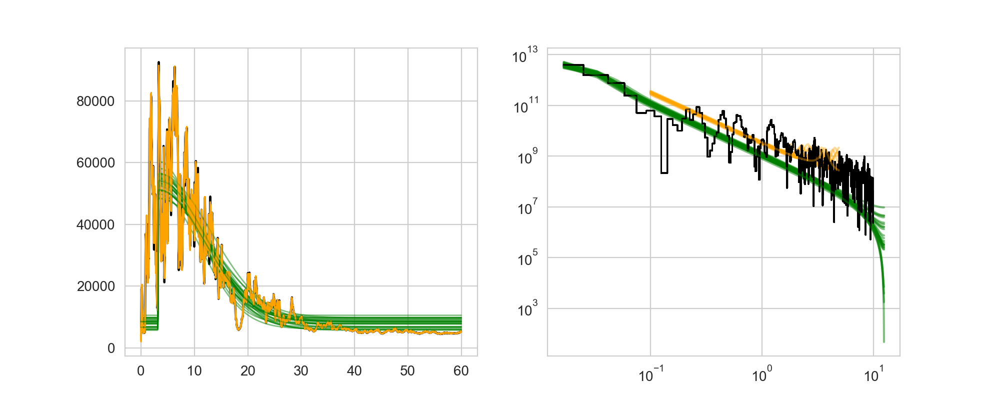

In [245]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.plot(lc.time, lc.counts, color="black")

np.random.seed(1000)
nsims = 25 # number of simulated light curves / PSDs
nsamples = samples[:,5].shape[0] 
idx_all = np.random.choice(np.arange(0, nsamples, 1, dtype=int), size=nsims, replace=False)

# time array for the posterior predictive examples
tpost = np.linspace(0.0, time[-1], 1500)
dt_post = tpost[1] - tpost[0]

# frequencies for the PSD
freq = np.fft.fftfreq(lc.n, d=lc.dt)
freq = freq[:int(lc.n/2)]
# calculate periodogram for comparison:
ps = Powerspectrum(lc, norm="abs")

for idx in idx_all:
    # mean parameters
    params = [samples_qpo[:,0][idx],
              samples_qpo[:,1][idx],
              samples_qpo[:,2][idx],
              samples_qpo[:,3][idx],
              samples_qpo[:,4][idx]]
    
    mean_post = skewgaussian(tpost, params)
    
    # kernel parameters
    log_alpha_post = [samples_qpo[:,5][idx],
                      samples_qpo[:,6][idx], 
                      samples_qpo[:,7][idx]]
    
    log_beta_post = [samples_qpo[:,8][idx]]

 
    post_carma30_kernel = CARMA_term(log_alpha_post, log_beta_post)

    log_qpo_amp_post = samples_qpo[:,9][idx]
    log_omega_post = samples_qpo[:,10][idx]
    log_quality_post = samples_qpo[:,11][idx]


    post_sho_kernel = celerite.terms.SHOTerm(log_S0=log_qpo_amp_post, 
                                             log_Q=log_quality_post, 
                                             log_omega0=log_omega_post)

    post_kernel = post_carma30_kernel + post_sho_kernel
    
    mean_model = SkewGaussian(*params)
    post_gp = celerite.GP(post_kernel, mean=mean_model, fit_mean=True)

    post_gp.compute(lc.time, np.sqrt(lc.counts))
    
    #kernel_post = CARMA.init(alpha=alpha_post, 
    #                    beta=beta_post, 
    #                    sigma=sigma_post)
    

    mu, var = post_gp.predict(lc.counts, tpost, return_var=True)
    #_, cond = post_gp.condition(lc.counts[:npoints], tpost, include_mean=True)

    ax1.plot(tpost, mu, lw=1, color="orange", alpha=0.4)
    ax1.plot(tpost, mean_post, lw=1, color="green", alpha=0.5)
    
    #psd = power_spectrum(freq, sigma_post, alpha_post, ma_coefs=[beta_post])
    
    freq = np.arange(0.1, 5.0, 0.1)
    psd = post_kernel.get_psd(2.*np.pi*freq) * len(lc.counts)
    
    ps_mean = Powerspectrum(Lightcurve(tpost, mean_post, dt=dt_post, skip_checks=True), norm="abs")
    
    ax2.loglog(ps.freq, ps.power, lw=1, color="black", ds="steps-mid")
    ax2.loglog(freq, psd, color="orange", alpha=0.4)
    ax2.loglog(ps_mean.freq, ps_mean.power, color="green", alpha=0.5)


In [32]:
mean_bkg = np.log(np.mean(lc.counts[-100:]))

def model_integral_with_qpo(t, y=None):

    # mean parameters
    log_amp = numpyro.sample('log_amp', dist.Uniform(9, 12.0))
    t0 = numpyro.sample("t0", dist.Uniform(0.0, 10))
    log_sig1 = numpyro.sample("log_sig1", dist.Uniform(-5, 2.5))
    log_sig2 = numpyro.sample("log_sig2", dist.Uniform(1, 4))
    log_const = numpyro.sample("log_const", dist.Normal(mean_bkg, mean_bkg/5))

    params = [log_amp, t0, log_sig1,log_sig2, log_const]
    
    mean = skewgaussian(t, params)
    # kernel parameters
    # kernel parameters
    log_alpha1 = numpyro.sample("log_alpha1", dist.Uniform(-10, 20))
    log_alpha2 = numpyro.sample("log_alpha2", dist.Uniform(-10, 20))
    log_alpha3 = numpyro.sample("log_alpha3", dist.Uniform(-10, 20))

    log_beta = numpyro.sample("log_beta", dist.Uniform(-10, 20))
    log_sigma = numpyro.sample("log_sigma", dist.Uniform(5, 15))

    # CARMA kernel
    kernel_carma = CARMA.init(
        alpha=[jnp.exp(log_alpha1), jnp.exp(log_alpha2), jnp.exp(log_alpha3)], 
        beta=[jnp.exp(log_beta)], 
        sigma=jnp.exp(log_sigma)

    )
    
    # QPO kernel parameters
    log_aqpo = numpyro.sample("log_aqpo", dist.Uniform(1, 15))
    log_cqpo = numpyro.sample("log_cqpo", dist.Uniform(-10, 2))
    log_freq = numpyro.sample("log_freq", dist.Uniform(np.log(0.1), np.log(5)))
    
    # QPO kernel
    kernel_qpo = kernels.quasisep.Celerite(
            a=jnp.exp(log_aqpo),
            b=0.0,
            c=jnp.exp(log_cqpo),
            d=2 * jnp.pi * jnp.exp(log_freq),
        )
    
    # add kernels together
    kernel = kernel_carma + kernel_qpo
    
    # gaussian process
    gp = GaussianProcess(kernel, t, diag=y, mean_value=mean)
    
    numpyro.sample("gp", gp.numpyro_dist(), obs=y)

    if y is not None:
        numpyro.deterministic("pred", gp.condition(y, t).gp.loc)

Let's sample this model, too:

In [33]:
npoints = lc.n
ns_qpo = NestedSampler(model_integral_with_qpo)
ns_qpo.run(random.PRNGKey(200), lc.time[:npoints], y=lc.counts[:npoints])

In [34]:
import pickle
with open(datadir + "integral_carma31_qpo_ns.pkl", "wb") as f:
    pickle.dump(ns_qpo, f)

In [35]:
samples_qpo, weights_qpo = ns_qpo.get_weighted_samples()

ns_qpo.print_summary()


--------
Termination Conditions:
Reached max samples
Small remaining evidence
--------
# likelihood evals: 2684925
# samples: 10000
# slices: 339300.0
# slices / acceptance: 39.0
# likelihood evals / sample: 268.5
# likelihood evals / slice: 7.9
--------
logZ=-11636.23 +- 0.27
H=12000.0
ESS=1073
--------
log_alpha1: mean +- std.dev. | 10%ile / 50%ile / 90%ile | MAP est. | max(L) est.
log_alpha1: -1.4 +- 1.5 | -3.2 / -1.0 / 0.1 | 0.6 | 0.6
--------
log_alpha2: mean +- std.dev. | 10%ile / 50%ile / 90%ile | MAP est. | max(L) est.
log_alpha2: 7.81 +- 0.33 | 7.68 / 7.76 / 7.86 | 7.77 | 7.77
--------
log_alpha3: mean +- std.dev. | 10%ile / 50%ile / 90%ile | MAP est. | max(L) est.
log_alpha3: 3.61 +- 0.16 | 3.49 / 3.62 / 3.76 | 3.63 | 3.63
--------
log_amp: mean +- std.dev. | 10%ile / 50%ile / 90%ile | MAP est. | max(L) est.
log_amp: 11.286 +- 0.085 | 11.19 / 11.278 / 11.4 | 11.223 | 11.223
--------
log_aqpo: mean +- std.dev. | 10%ile / 50%ile / 90%ile | MAP est. | max(L) est.
log_aqpo: 9.9 +

pred[91]: -35200.0 +- 7100.0 | -44700.0 / -34100.0 / -27700.0 | -29500.0 | -29500.0
pred[92]: -46500.0 +- 7100.0 | -56000.0 / -45500.0 / -39000.0 | -40900.0 | -40900.0
pred[93]: -42700.0 +- 7100.0 | -52200.0 / -41600.0 / -35200.0 | -37100.0 | -37100.0
pred[94]: -35100.0 +- 7100.0 | -44600.0 / -34000.0 / -27600.0 | -29500.0 | -29500.0
pred[95]: -25700.0 +- 7100.0 | -35200.0 / -24700.0 / -18200.0 | -20100.0 | -20100.0
pred[96]: -16600.0 +- 7100.0 | -26200.0 / -15600.0 / -9100.0 | -11000.0 | -11000.0
pred[97]: -11900.0 +- 7100.0 | -21400.0 / -10900.0 / -4400.0 | -6300.0 | -6300.0
pred[98]: -31900.0 +- 7100.0 | -41400.0 / -30800.0 / -24400.0 | -26300.0 | -26300.0
pred[99]: -48100.0 +- 7100.0 | -57700.0 / -47100.0 / -40600.0 | -42500.0 | -42500.0
pred[100]: -20900.0 +- 7100.0 | -30500.0 / -19900.0 / -13500.0 | -15300.0 | -15300.0
pred[101]: -23500.0 +- 7100.0 | -33000.0 / -22500.0 / -16000.0 | -17900.0 | -17900.0
pred[102]: -21300.0 +- 7100.0 | -30900.0 / -20300.0 / -13800.0 | -15700.0 | -1

pred[224]: -51400.0 +- 7300.0 | -61400.0 / -50300.0 / -43500.0 | -46200.0 | -46200.0
pred[225]: -40600.0 +- 7300.0 | -50600.0 / -39600.0 / -32800.0 | -35400.0 | -35400.0
pred[226]: -36100.0 +- 7300.0 | -46100.0 / -35000.0 / -28200.0 | -30900.0 | -30900.0
pred[227]: -39200.0 +- 7300.0 | -49300.0 / -38200.0 / -31300.0 | -34000.0 | -34000.0
pred[228]: -39100.0 +- 7300.0 | -49100.0 / -38000.0 / -31200.0 | -33900.0 | -33900.0
pred[229]: -45800.0 +- 7300.0 | -55800.0 / -44700.0 / -37900.0 | -40600.0 | -40600.0
pred[230]: -51900.0 +- 7300.0 | -61900.0 / -50800.0 / -44000.0 | -46700.0 | -46700.0
pred[231]: -51200.0 +- 7300.0 | -61200.0 / -50100.0 / -43200.0 | -46000.0 | -46000.0
pred[232]: -50900.0 +- 7300.0 | -60900.0 / -49800.0 / -43000.0 | -45700.0 | -45700.0
pred[233]: -49800.0 +- 7300.0 | -59800.0 / -48700.0 / -41800.0 | -44600.0 | -44600.0
pred[234]: -53300.0 +- 7300.0 | -63300.0 / -52200.0 / -45300.0 | -48100.0 | -48100.0
pred[235]: -56500.0 +- 7300.0 | -66600.0 / -55400.0 / -48600.0 | 

pred[382]: -62900.0 +- 8000.0 | -74500.0 / -61700.0 / -54200.0 | -58800.0 | -58800.0
pred[383]: -60000.0 +- 8000.0 | -71600.0 / -58800.0 / -51200.0 | -55800.0 | -55800.0
pred[384]: -60000.0 +- 8000.0 | -71600.0 / -58800.0 / -51200.0 | -55900.0 | -55900.0
pred[385]: -60300.0 +- 8100.0 | -71900.0 / -59100.0 / -51400.0 | -56200.0 | -56200.0
pred[386]: -60900.0 +- 8100.0 | -72500.0 / -59600.0 / -52000.0 | -56700.0 | -56700.0
pred[387]: -59100.0 +- 8100.0 | -70700.0 / -57900.0 / -50200.0 | -55000.0 | -55000.0
pred[388]: -57600.0 +- 8100.0 | -69300.0 / -56400.0 / -48800.0 | -53600.0 | -53600.0
pred[389]: -57400.0 +- 8100.0 | -69100.0 / -56200.0 / -48500.0 | -53300.0 | -53300.0
pred[390]: -56500.0 +- 8100.0 | -68200.0 / -55200.0 / -47600.0 | -52400.0 | -52400.0
pred[391]: -57200.0 +- 8100.0 | -68900.0 / -55900.0 / -48300.0 | -53100.0 | -53100.0
pred[392]: -58800.0 +- 8100.0 | -70500.0 / -57500.0 / -49900.0 | -54700.0 | -54700.0
pred[393]: -59800.0 +- 8100.0 | -71500.0 / -58600.0 / -50900.0 | 

pred[524]: -61500.0 +- 9300.0 | -75000.0 / -59900.0 / -51900.0 | -58700.0 | -58700.0
pred[525]: -61800.0 +- 9300.0 | -75300.0 / -60100.0 / -52100.0 | -58900.0 | -58900.0
pred[526]: -61800.0 +- 9300.0 | -75400.0 / -60200.0 / -52200.0 | -59000.0 | -59000.0
pred[527]: -61400.0 +- 9400.0 | -74900.0 / -59700.0 / -51700.0 | -58500.0 | -58500.0
pred[528]: -61000.0 +- 9400.0 | -74500.0 / -59300.0 / -51300.0 | -58100.0 | -58100.0
pred[529]: -60600.0 +- 9400.0 | -74200.0 / -58900.0 / -50900.0 | -57700.0 | -57700.0
pred[530]: -59200.0 +- 9400.0 | -72800.0 / -57600.0 / -49500.0 | -56400.0 | -56400.0
pred[531]: -58600.0 +- 9400.0 | -72200.0 / -56900.0 / -48900.0 | -55700.0 | -55700.0
pred[532]: -58100.0 +- 9400.0 | -71700.0 / -56400.0 / -48400.0 | -55300.0 | -55300.0
pred[533]: -57700.0 +- 9400.0 | -71400.0 / -56000.0 / -48000.0 | -54900.0 | -54900.0
pred[534]: -57500.0 +- 9400.0 | -71200.0 / -55800.0 / -47800.0 | -54800.0 | -54800.0
pred[535]: -57900.0 +- 9400.0 | -71600.0 / -56200.0 / -48100.0 | 

pred[655]: -55000.0 +- 11000.0 | -71000.0 / -53000.0 / -44000.0 | -53000.0 | -53000.0
pred[656]: -55000.0 +- 11000.0 | -70000.0 / -53000.0 / -44000.0 | -53000.0 | -53000.0
pred[657]: -55000.0 +- 11000.0 | -70000.0 / -53000.0 / -44000.0 | -53000.0 | -53000.0
pred[658]: -54000.0 +- 11000.0 | -70000.0 / -52000.0 / -43000.0 | -52000.0 | -52000.0
pred[659]: -54000.0 +- 11000.0 | -69000.0 / -52000.0 / -43000.0 | -52000.0 | -52000.0
pred[660]: -53000.0 +- 11000.0 | -69000.0 / -51000.0 / -42000.0 | -51000.0 | -51000.0
pred[661]: -52000.0 +- 11000.0 | -68000.0 / -50000.0 / -42000.0 | -51000.0 | -51000.0
pred[662]: -52000.0 +- 11000.0 | -68000.0 / -50000.0 / -42000.0 | -51000.0 | -51000.0
pred[663]: -52000.0 +- 11000.0 | -68000.0 / -50000.0 / -41000.0 | -51000.0 | -51000.0
pred[664]: -53000.0 +- 11000.0 | -68000.0 / -51000.0 / -42000.0 | -51000.0 | -51000.0
pred[665]: -53000.0 +- 11000.0 | -68000.0 / -51000.0 / -42000.0 | -51000.0 | -51000.0
pred[666]: -53000.0 +- 11000.0 | -69000.0 / -51000.0 /

pred[758]: -49000.0 +- 12000.0 | -66000.0 / -47000.0 / -37000.0 | -48000.0 | -48000.0
pred[759]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -37000.0 | -47000.0 | -47000.0
pred[760]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -37000.0 | -48000.0 | -48000.0
pred[761]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[762]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[763]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[764]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[765]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[766]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[767]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 / -36000.0 | -47000.0 | -47000.0
pred[768]: -48000.0 +- 12000.0 | -66000.0 / -46000.0 / -37000.0 | -48000.0 | -48000.0
pred[769]: -48000.0 +- 12000.0 | -65000.0 / -46000.0 /

pred[897]: -41000.0 +- 12000.0 | -59000.0 / -39000.0 / -28000.0 | -41000.0 | -41000.0
pred[898]: -41000.0 +- 12000.0 | -59000.0 / -39000.0 / -28000.0 | -41000.0 | -41000.0
pred[899]: -41000.0 +- 12000.0 | -59000.0 / -39000.0 / -28000.0 | -41000.0 | -41000.0
pred[900]: -41000.0 +- 12000.0 | -59000.0 / -39000.0 / -28000.0 | -41000.0 | -41000.0
pred[901]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[902]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[903]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[904]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[905]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[906]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[907]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 / -28000.0 | -41000.0 | -41000.0
pred[908]: -41000.0 +- 12000.0 | -59000.0 / -38000.0 /

pred[1076]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1077]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1078]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1079]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1080]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1081]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1082]: -31000.0 +- 13000.0 | -49000.0 / -28000.0 / -17000.0 | -31000.0 | -31000.0
pred[1083]: -30000.0 +- 13000.0 | -49000.0 / -27000.0 / -17000.0 | -31000.0 | -31000.0
pred[1084]: -31000.0 +- 13000.0 | -49000.0 / -27000.0 / -17000.0 | -31000.0 | -31000.0
pred[1085]: -30000.0 +- 13000.0 | -49000.0 / -27000.0 / -17000.0 | -31000.0 | -31000.0
pred[1086]: -30000.0 +- 13000.0 | -49000.0 / -27000.0 / -16000.0 | -30000.0 | -30000.0
pred[1087]: -30000.0 +- 13000.0 | -49000.0 

In [36]:
logZ_carma= -11631.82
logZ_qpo = -11636.23

In [37]:
logZ_carma - logZ_qpo

4.4099999999998545

<IPython.core.display.Javascript object>


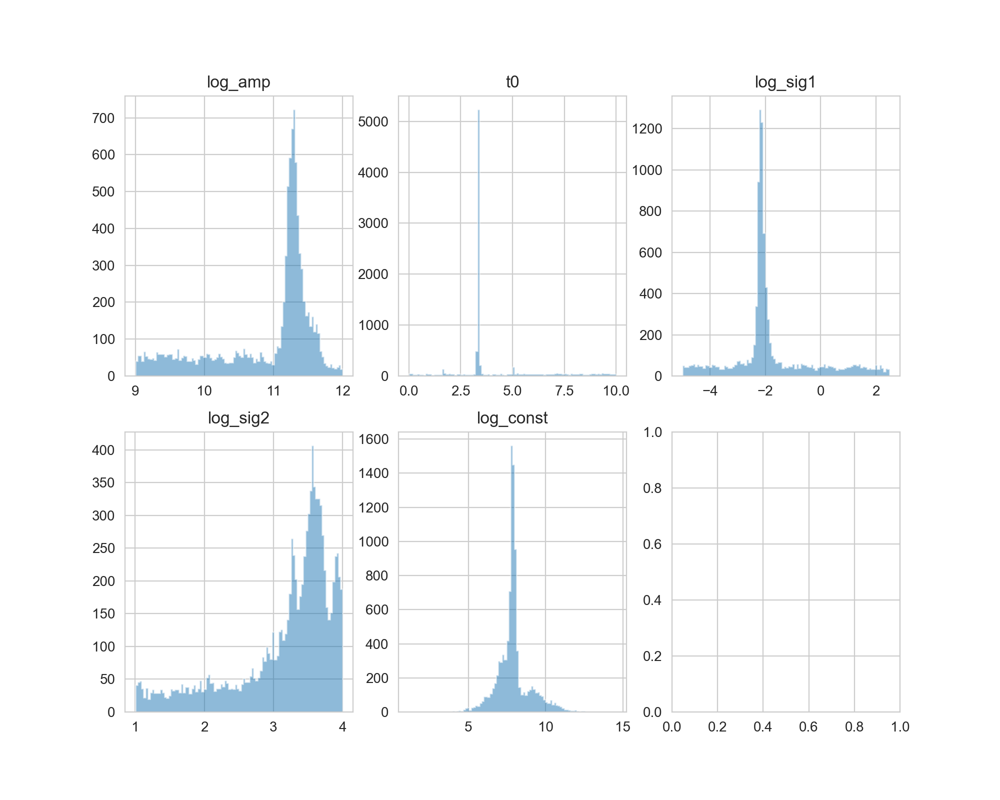

In [38]:
mean_var_names = ["log_amp", "t0", "log_sig1",
                  'log_sig2', "log_const"]

fig, axes = plt.subplots(2, 3, figsize=(10, 8))
axes = np.hstack(axes)

for i, vn in enumerate(mean_var_names):
    samp = samples_qpo[vn].block_until_ready()  
    axes[i].hist(samp, bins=100, histtype="stepfilled", alpha=0.5)
    axes[i].set_title(vn)
    #axes[i].axvline(mean_params_true[i], lw=2, color="red")

<IPython.core.display.Javascript object>


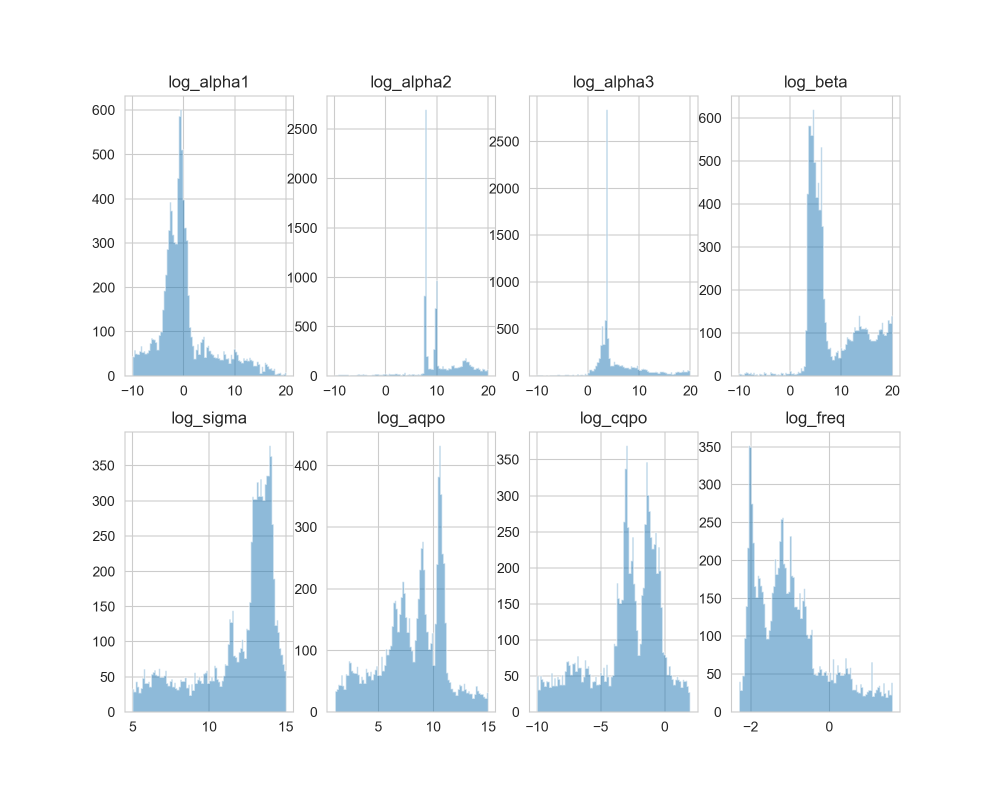

In [39]:
kernel_var_names = ["log_alpha1", "log_alpha2", "log_alpha3",
                    "log_beta", "log_sigma", "log_aqpo", 
                    "log_cqpo", "log_freq"]


fig, axes = plt.subplots(2, 4, figsize=(10, 8))
axes = np.hstack(axes)

for i, vn in enumerate(kernel_var_names):
    samp = samples_qpo[vn].block_until_ready()  
    axes[i].hist(samp, bins=100, histtype="stepfilled", alpha=0.5)
    axes[i].set_title(vn)
    #axes[i].axvline(np.log(kernel_params_true[i]), lw=2, color="red")

In [40]:
def lorentzian(freq, amp, f0, fwhm):
    """
    A Lorentzian function (Cauchy distribution)
    
    Parameters
    ----------
    freq : numpy.ndarray
        An array of frequencies for which to 
        compute the Lorentzian
        
    amp : float
        The amplitude of the Lorentzian
        
    f0 : float
        The centroid frequency of the Lorentzian
        
    fwhm : float
        The full-width at half-maximum of the 
        Lorentzian
        
    Returns
    -------
    lor : numpy.ndarray
        The values of the Lorentzian for the 
        given parameters and frequency array
    
    """
    num = amp * fwhm**2.
    denom = fwhm**2. + (freq - f0)**2.0
    
    return num/denom   

In [42]:
1/0.8

1.25

<IPython.core.display.Javascript object>


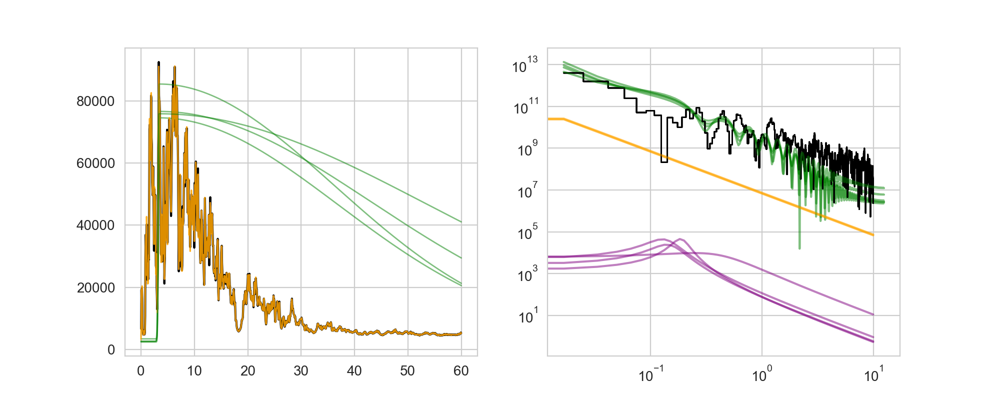

In [41]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4))

ax1.plot(lc.time[:npoints], lc.counts[:npoints], color="black")

np.random.seed(1000)
nsims = 4 # number of simulated light curves / PSDs
nsamples = samples_qpo["log_alpha1"].shape[0]
idx_all = np.random.choice(np.arange(0, nsamples, 1, dtype=int), size=nsims, replace=False)

# time array for the posterior predictive examples
tpost = np.linspace(0.0, time[-1], 1500)
dt_post = tpost[1] - tpost[0]

# frequencies for the PSD
freq = np.fft.fftfreq(lc.n, d=lc.dt)
freq = freq[:int(lc.n/2)]
# calculate periodogram for comparison:
ps = Powerspectrum(lc, norm="abs")

for idx in idx_all:
    # mean parameters
    params = [samples_qpo["log_amp"][idx],
              samples_qpo["t0"][idx],
              samples_qpo["log_sig1"][idx],
              samples_qpo["log_sig2"][idx],
              samples_qpo["log_const"][idx]]
    
    mean_post = skewgaussian(tpost, params)
    
    # kernel parameters
    alpha_post = [jnp.exp(samples_qpo["log_alpha1"][idx]),
             jnp.exp(samples_qpo["log_alpha2"][idx]),
             jnp.exp(samples_qpo["log_alpha3"][idx])]
    
    beta_post = jnp.exp(samples_qpo["log_beta"][idx])
    sigma_post = jnp.exp(samples_qpo["log_sigma"][idx])

    
    kernel_carma = CARMA.init(alpha=alpha_post, 
                        beta=beta_post, 
                        sigma=sigma_post)
    
    
    aqpo_post = jnp.exp(samples_qpo["log_aqpo"][idx])
    cqpo_post = jnp.exp(samples_qpo["log_cqpo"][idx])
    freq_post = jnp.exp(samples_qpo['log_freq'][idx])
    
    # QPO kernel
    kernel_qpo = kernels.quasisep.Celerite(
            a=aqpo_post,
            b=0.0,
            c=cqpo_post,
            d=2 * jnp.pi * freq_post
        )
    
    # add kernels together
    kernel_post = kernel_carma + kernel_qpo
    
    gp = GaussianProcess(kernel_post, lc.time[:npoints], diag=0.01)

    _, cond = gp.condition(lc.counts[:npoints], tpost, include_mean=True)

    ax1.plot(tpost, cond.loc, lw=1, color="orange", alpha=0.4)
    ax1.plot(tpost, mean_post, lw=1, color="green", alpha=0.5)
    
    # PSD of the CARMA process
    psd_carma = power_spectrum(freq, sigma_post, alpha_post, ma_coefs=[beta_post])
    psd_lor = lorentzian(freq, aqpo_post, freq_post, cqpo_post)
    
    ps_mean = Powerspectrum(Lightcurve(tpost, mean_post, dt=dt_post, skip_checks=True), norm="abs")
    
    ax2.loglog(ps.freq, ps.power, lw=1, color="black", ds="steps-mid")
    ax2.loglog(freq, psd_carma, color="orange", alpha=0.4)
    ax2.loglog(ps_mean.freq, ps_mean.power, color="green", alpha=0.5)
    ax2.loglog(freq, psd_lor, color="purple", alpha=0.5)


1200